## Tools

In [ ]:
pip install pytorch-metric-learning

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 110.8/110.8 kB 2.8 MB/s eta 0:00:00


## MNIST Dataset

### ArcFace

In [ ]:
import torch
import torchvision
import numpy as np
import pytorch_metric_learning
from pytorch_metric_learning import losses
from torchvision import transforms, datasets
import torch.nn as nn
import torch.optim as optim

# 超参数
batch_size = 256
learning_rate = 0.01
num_epochs = 10
num_classes = 10 # MNIST有10个类别
embedding_size = 512 # 假设你的网络输出512维的嵌入向量
margin = 28.6 # 这是论文中推荐的值
scale = 64 # 这也是论文中推荐的值

# 定义一个转换函数，将灰度图像复制三次成为RGB图像
def gray_to_rgb(x):
    x = np.repeat(x, 3, axis=0)
    return x

# 定义一个数据转换器，包含上述函数和其他操作
transform = transforms.Compose([
    transforms.ToTensor(), # 将图像转换为张量，并将数值范围从[0,255]变为[0,1]
    transforms.Lambda(gray_to_rgb), # 将灰度图像转换为RGB图像
    transforms.Resize((32, 32)), # 将图像大小调整为32x32
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)) # 将图像归一化，使其数值范围为[-1,1]
])

# 加载MNIST数据集，并应用上述转换器
train_dataset = datasets.MNIST(root='./data', train=True, download=True, transform=transform)
test_dataset = datasets.MNIST(root='./data', train=False, download=True, transform=transform)

# 创建数据加载器，用于分批加载数据
train_loader = torch.utils.data.DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
test_loader = torch.utils.data.DataLoader(test_dataset, batch_size=batch_size, shuffle=False)

# 获取预训练的ResNet-18模型
model = torchvision.models.resnet18(pretrained=False)

# 修改最后一层全连接层的输出特征数为embedding_size
num_features = model.fc.in_features # 获取全连接层的输入特征数
model.fc = nn.Linear(num_features, embedding_size) # 创建一个新的全连接层，并替换原来的全连接层

# 如果有GPU可用，则将模型移动到GPU上
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
model.to(device)

# 创建一个ArcFaceLoss对象，并传入相应的参数
loss_func = losses.ArcFaceLoss(num_classes=num_classes, embedding_size=embedding_size, margin=margin, scale=scale)

# 创建一个优化器，并将ArcFaceLoss对象的参数传递给它
optimizer = optim.SGD(list(model.parameters()) + list(loss_func.parameters()), lr=learning_rate)

# 编写训练和测试的循环，用于迭代地更新模型和损失函数的参数，并评估模型的性能
for epoch in range(num_epochs):
    # 训练阶段
    model.train() # 设置模型为训练模式
    train_loss = 0.0 # 初始化训练损失
    for data, labels in train_loader: # 遍历训练数据
        data = data.to(device) # 将图像移动到设备上
        labels = labels.to(device) # 将标签移动到设备上
        optimizer.zero_grad() # 清空梯度缓存
        embeddings = model(data) # 通过模型得到嵌入向量
        loss = loss_func(embeddings, labels) # 通过损失函数计算损失值
        loss.backward() # 反向传播计算梯度
        optimizer.step() # 更新参数
        train_loss += loss.item() * data.size(0) # 累加训练损失

    # 测试阶段
    model.eval() # 设置模型为评估模式
    test_loss = 0.0 # 初始化测试损失
    test_acc = 0.0 # 初始化测试准确率
    with torch.no_grad(): # 不计算梯度，节省内存和时间
        for data, labels in test_loader: # 遍历测试数据
            data = data.to(device) # 将图像移动到设备上
            labels = labels.to(device) # 将标签移动到设备上
            embeddings = model(data) # 通过模型得到嵌入向量
            loss = loss_func(embeddings, labels) # 通过损失函数计算损失值
            test_loss += loss.item() * data.size(0) # 累加测试损失
            logits = loss_func.get_logits(embeddings) # 通过损失函数得到分类的logits
            preds = torch.argmax(logits, dim=1) # 得到预测的类别
            test_acc += torch.sum(preds == labels).item() # 累加正确预测的数量

    # 打印每个epoch的结果
    train_loss /= len(train_dataset) # 计算平均训练损失
    test_loss /= len(test_dataset) # 计算平均测试损失
    test_acc /= len(test_dataset) # 计算测试准确率
    print(f'Epoch {epoch+1}, Train Loss: {train_loss:.4f}, Test Loss: {test_loss:.4f}, Test Acc: {test_acc:.4f}')


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=None`.
  warnings.warn(msg)
/usr/local/lib/python3.10/dist-packages/torchvision/transforms/functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialia

Epoch 1, Train Loss: 3.0649, Test Loss: 1.5460, Test Acc: 0.9778
Epoch 2, Train Loss: 0.8510, Test Loss: 1.2124, Test Acc: 0.9836
Epoch 3, Train Loss: 0.5635, Test Loss: 1.3911, Test Acc: 0.9804
Epoch 4, Train Loss: 0.4445, Test Loss: 0.8985, Test Acc: 0.9871
Epoch 5, Train Loss: 0.3342, Test Loss: 0.8981, Test Acc: 0.9873
Epoch 6, Train Loss: 0.2833, Test Loss: 0.4975, Test Acc: 0.9929
Epoch 7, Train Loss: 0.2274, Test Loss: 1.0078, Test Acc: 0.9856
Epoch 8, Train Loss: 0.1830, Test Loss: 0.5024, Test Acc: 0.9927
Epoch 9, Train Loss: 0.1525, Test Loss: 0.5803, Test Acc: 0.9919
Epoch 10, Train Loss: 0.1317, Test Loss: 0.4283, Test Acc: 0.9939


/usr/local/lib/python3.10/dist-packages/torchvision/transforms/functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works on Tensors - PIL will still use antialiasing). This also applies if you are using the inference transforms from the models weights: update the call to weights.transforms(antialias=True).
  warnings.warn(


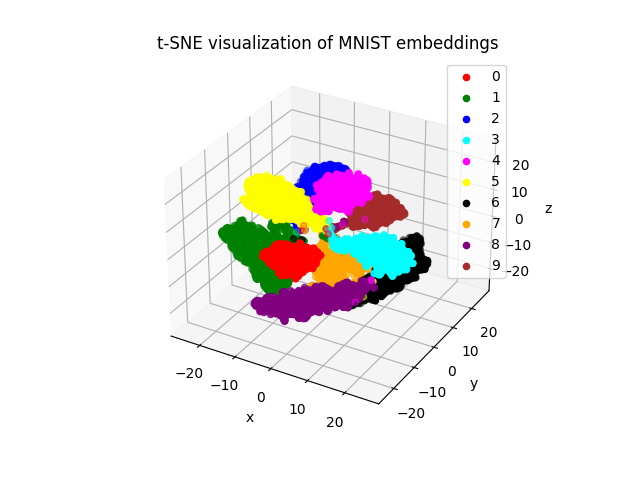

In [ ]:
# 导入matplotlib.pyplot和其他必要的库
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import numpy as np
from sklearn.manifold import TSNE

# 假设你的模型已经训练好了，并且保存在model变量中
# 假设你的测试数据集已经加载好了，并且保存在test_loader变量中

# 创建一个空的列表，用于存储嵌入向量和标签
embeddings = []
labels = []

# 遍历测试数据集，通过模型得到嵌入向量，并将它们和标签添加到列表中
with torch.no_grad(): # 不计算梯度，节省内存和时间
    for data, label in test_loader: # 遍历测试数据
        data = data.to(device) # 将图像移动到设备上
        label = label.to(device) # 将标签移动到设备上
        embedding = model(data) # 通过模型得到嵌入向量
        embeddings.append(embedding) # 将嵌入向量添加到列表中
        labels.append(label) # 将标签添加到列表中

# 将列表转换为numpy数组，并将嵌入向量的维度降为2或3，用于可视化
embeddings = torch.cat(embeddings, dim=0).cpu().numpy() # 将嵌入向量拼接起来，并转换为numpy数组
labels = torch.cat(labels, dim=0).cpu().numpy() # 将标签拼接起来，并转换为numpy数组
tsne = TSNE(n_components=3, perplexity=30, n_iter=1000) # 创建一个TSNE对象，并设置参数
embeddings_3d = tsne.fit_transform(embeddings) # 使用TSNE对象对嵌入向量进行降维，得到三维的坐标

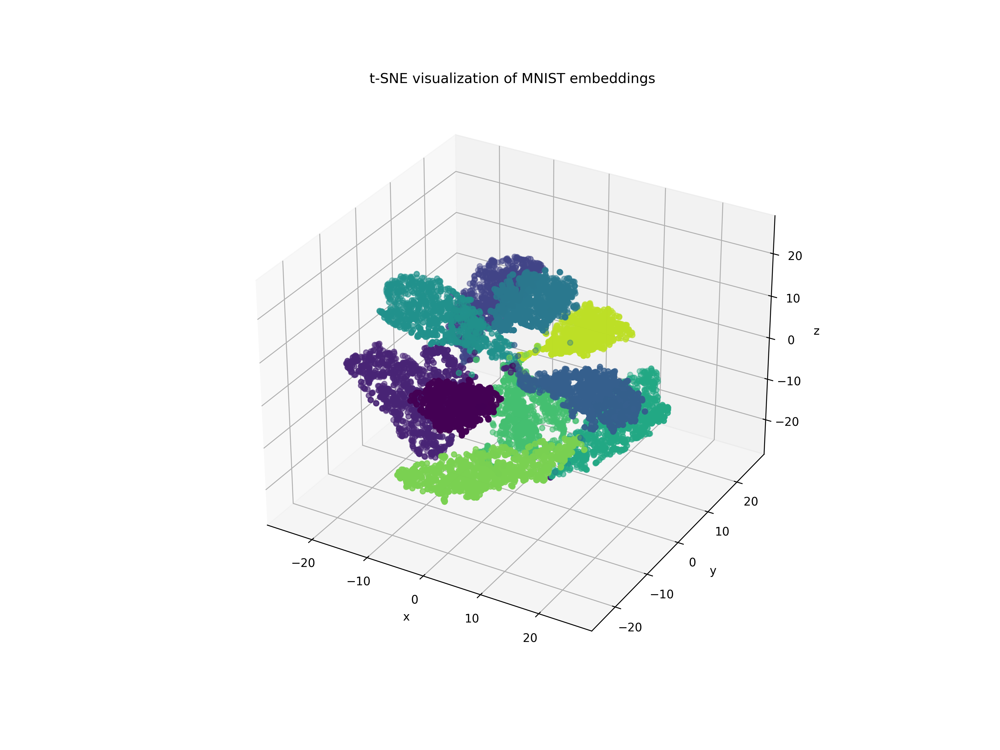

In [ ]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import numpy as np
import ipywidgets as widgets
from IPython.display import display

# 创建一个三维的图形对象，并设置标题和坐标轴标签
fig = plt.figure(figsize=(12, 9), dpi=300)
ax = fig.add_subplot(111, projection='3d')
ax.set_title('t-SNE visualization of MNIST embeddings')
ax.set_xlabel('x')
ax.set_ylabel('y')
ax.set_zlabel('z')

# 定义一个色系
cmap = plt.get_cmap('viridis')

# 遍历每个类别，绘制对应颜色的散点图，并添加图例
for i in range(num_classes):
    indices = labels == i  # 找到属于该类别的索引
    x = embeddings_3d[indices, 0]  # 找到对应的x坐标
    y = embeddings_3d[indices, 1]  # 找到对应的y坐标
    z = embeddings_3d[indices, 2]  # 找到对应的z坐标
    color = np.array([cmap(float(i) / num_classes)])  # 将颜色值封装为数组
    ax.scatter(x, y, z, c=color, label=str(i))  # 绘制散点图，并设置颜色和标签

# 创建一个输出小部件
output_widget = widgets.Output()

# 显示图像
with output_widget:
    display(fig)

# 创建一个控制旋转的小部件
rotation_slider = widgets.FloatSlider(min=-180, max=180, value=0, description='Rotation')

# 定义一个函数来更新图像的旋转角度
def update_rotation_angle(change):
    angle = change.new
    ax.view_init(elev=30, azim=angle)
    with output_widget:
        output_widget.clear_output(wait=True)
        display(fig)

# 将更新函数绑定到旋转小部件的值变化事件
rotation_slider.observe(update_rotation_angle, 'value')

# 创建一个垂直布局小部件来显示图像和旋转控制
vbox = widgets.VBox([output_widget, rotation_slider])

# 显示垂直布局小部件
display(vbox)


### CosFace

In [ ]:
import torch
import torchvision
import numpy as np
import pytorch_metric_learning
from pytorch_metric_learning import losses
from torchvision import transforms, datasets
import torch.nn as nn
import torch.optim as optim

# 超参数
batch_size = 256
learning_rate = 0.01
num_epochs = 10
num_classes = 10 # MNIST有10个类别
embedding_size = 512 # 假设你的网络输出512维的嵌入向量
margin = 28.6 # 这是论文中推荐的值
scale = 64 # 这也是论文中推荐的值

# 定义一个转换函数，将灰度图像复制三次成为RGB图像
def gray_to_rgb(x):
    x = np.repeat(x, 3, axis=0)
    return x

# 定义一个数据转换器，包含上述函数和其他操作
transform = transforms.Compose([
    transforms.ToTensor(), # 将图像转换为张量，并将数值范围从[0,255]变为[0,1]
    transforms.Lambda(gray_to_rgb), # 将灰度图像转换为RGB图像
    transforms.Resize((32, 32)), # 将图像大小调整为32x32
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)) # 将图像归一化，使其数值范围为[-1,1]
])

# 加载MNIST数据集，并应用上述转换器
train_dataset = datasets.MNIST(root='./data', train=True, download=True, transform=transform)
test_dataset = datasets.MNIST(root='./data', train=False, download=True, transform=transform)

# 创建数据加载器，用于分批加载数据
train_loader = torch.utils.data.DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
test_loader = torch.utils.data.DataLoader(test_dataset, batch_size=batch_size, shuffle=False)

# 获取预训练的ResNet-18模型
model = torchvision.models.resnet18(pretrained=False)

# 修改最后一层全连接层的输出特征数为embedding_size
num_features = model.fc.in_features # 获取全连接层的输入特征数
model.fc = nn.Linear(num_features, embedding_size) # 创建一个新的全连接层，并替换原来的全连接层

# 如果有GPU可用，则将模型移动到GPU上
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
model.to(device)

# 创建一个CosFaceLoss对象，并传入相应的参数
loss_func = losses.CosFaceLoss(num_classes=num_classes, embedding_size=embedding_size, margin=margin, scale=scale)

# 创建一个优化器，并将CosFaceLoss对象的参数传递给它
optimizer = optim.SGD(list(model.parameters()) + list(loss_func.parameters()), lr=learning_rate)

# 编写训练和测试的循环，用于迭代地更新模型和损失函数的参数，并评估模型的性能
for epoch in range(num_epochs):
    # 训练阶段
    model.train() # 设置模型为训练模式
    train_loss = 0.0 # 初始化训练损失
    for data, labels in train_loader: # 遍历训练数据
        data = data.to(device) # 将图像移动到设备上
        labels = labels.to(device) # 将标签移动到设备上
        optimizer.zero_grad() # 清空梯度缓存
        embeddings = model(data) # 通过模型得到嵌入向量
        loss = loss_func(embeddings, labels) # 通过损失函数计算损失值
        loss.backward() # 反向传播计算梯度
        optimizer.step() # 更新参数
        train_loss += loss.item() * data.size(0) # 累加训练损失

    # 测试阶段
    model.eval() # 设置模型为评估模式
    test_loss = 0.0 # 初始化测试损失
    test_acc = 0.0 # 初始化测试准确率
    with torch.no_grad(): # 不计算梯度，节省内存和时间
        for data, labels in test_loader: # 遍历测试数据
            data = data.to(device) # 将图像移动到设备上
            labels = labels.to(device) # 将标签移动到设备上
            embeddings = model(data) # 通过模型得到嵌入向量
            loss = loss_func(embeddings, labels) # 通过损失函数计算损失值
            test_loss += loss.item() * data.size(0) # 累加测试损失
            logits = loss_func.get_logits(embeddings) # 通过损失函数得到分类的logits
            preds = torch.argmax(logits, dim=1) # 得到预测的类别
            test_acc += torch.sum(preds == labels).item() # 累加正确预测的数量

    # 打印每个epoch的结果
    train_loss /= len(train_dataset) # 计算平均训练损失
    test_loss /= len(test_dataset) # 计算平均测试损失
    test_acc /= len(test_dataset) # 计算测试准确率
    print(f'Epoch {epoch+1}, Train Loss: {train_loss:.4f}, Test Loss: {test_loss:.4f}, Test Acc: {test_acc:.4f}')


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=None`.
  warnings.warn(msg)
/usr/local/lib/python3.10/dist-packages/torchvision/transforms/functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialia

Epoch 1, Train Loss: 1773.6804, Test Loss: 1767.9786, Test Acc: 0.9865
Epoch 2, Train Loss: 1767.4677, Test Loss: 1767.0244, Test Acc: 0.9884
Epoch 3, Train Loss: 1766.7132, Test Loss: 1771.8091, Test Acc: 0.9513
Epoch 4, Train Loss: 1766.2355, Test Loss: 1767.2318, Test Acc: 0.9832
Epoch 5, Train Loss: 1765.7388, Test Loss: 1766.0420, Test Acc: 0.9897
Epoch 6, Train Loss: 1765.3978, Test Loss: 1767.8970, Test Acc: 0.9744
Epoch 7, Train Loss: 1765.0295, Test Loss: 1765.9391, Test Acc: 0.9872
Epoch 8, Train Loss: 1764.7864, Test Loss: 1765.4219, Test Acc: 0.9900
Epoch 9, Train Loss: 1764.5876, Test Loss: 1764.8354, Test Acc: 0.9926
Epoch 10, Train Loss: 1764.3299, Test Loss: 1764.6043, Test Acc: 0.9935


In [ ]:
# 导入matplotlib.pyplot和其他必要的库
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import numpy as np
from sklearn.manifold import TSNE

# 假设你的模型已经训练好了，并且保存在model变量中
# 假设你的测试数据集已经加载好了，并且保存在test_loader变量中

# 创建一个空的列表，用于存储嵌入向量和标签
embeddings = []
labels = []

# 遍历测试数据集，通过模型得到嵌入向量，并将它们和标签添加到列表中
with torch.no_grad(): # 不计算梯度，节省内存和时间
    for data, label in test_loader: # 遍历测试数据
        data = data.to(device) # 将图像移动到设备上
        label = label.to(device) # 将标签移动到设备上
        embedding = model(data) # 通过模型得到嵌入向量
        embeddings.append(embedding) # 将嵌入向量添加到列表中
        labels.append(label) # 将标签添加到列表中

# 将列表转换为numpy数组，并将嵌入向量的维度降为2或3，用于可视化
embeddings = torch.cat(embeddings, dim=0).cpu().numpy() # 将嵌入向量拼接起来，并转换为numpy数组
labels = torch.cat(labels, dim=0).cpu().numpy() # 将标签拼接起来，并转换为numpy数组
tsne = TSNE(n_components=3, perplexity=30, n_iter=1000) # 创建一个TSNE对象，并设置参数
embeddings_3d = tsne.fit_transform(embeddings) # 使用TSNE对象对嵌入向量进行降维，得到三维的坐标

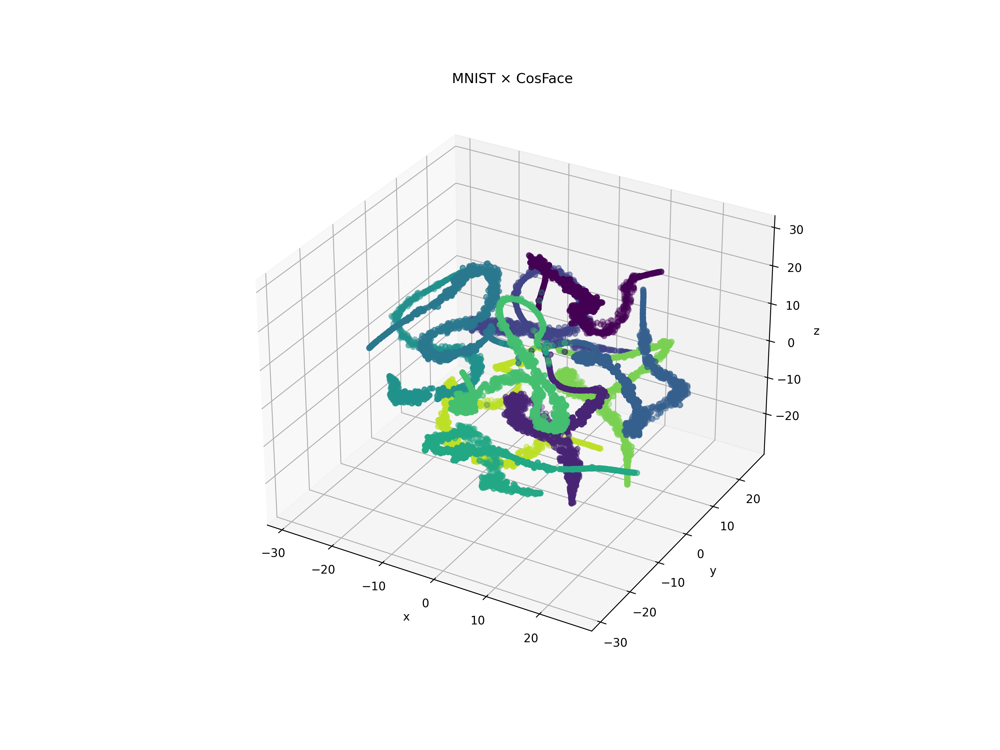

In [ ]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import numpy as np
import ipywidgets as widgets
from IPython.display import display

# 创建一个三维的图形对象，并设置标题和坐标轴标签
fig = plt.figure(figsize=(12, 9), dpi=300)
ax = fig.add_subplot(111, projection='3d')
ax.set_title('MNIST × CosFace')
ax.set_xlabel('x')
ax.set_ylabel('y')
ax.set_zlabel('z')

# 定义一个色系
cmap = plt.get_cmap('viridis')

# 遍历每个类别，绘制对应颜色的散点图，并添加图例
for i in range(num_classes):
    indices = labels == i  # 找到属于该类别的索引
    x = embeddings_3d[indices, 0]  # 找到对应的x坐标
    y = embeddings_3d[indices, 1]  # 找到对应的y坐标
    z = embeddings_3d[indices, 2]  # 找到对应的z坐标
    color = np.array([cmap(float(i) / num_classes)])  # 将颜色值封装为数组
    ax.scatter(x, y, z, c=color, label=str(i))  # 绘制散点图，并设置颜色和标签

# 创建一个输出小部件
output_widget = widgets.Output()

# 显示图像
with output_widget:
    display(fig)

# 创建一个控制旋转的小部件
rotation_slider = widgets.FloatSlider(min=-180, max=180, value=0, description='Rotation')

# 定义一个函数来更新图像的旋转角度
def update_rotation_angle(change):
    angle = change.new
    ax.view_init(elev=30, azim=angle)
    with output_widget:
        output_widget.clear_output(wait=True)
        display(fig)

# 将更新函数绑定到旋转小部件的值变化事件
rotation_slider.observe(update_rotation_angle, 'value')

# 创建一个垂直布局小部件来显示图像和旋转控制
vbox = widgets.VBox([output_widget, rotation_slider])

# 显示垂直布局小部件
display(vbox)


### TripletMarginLoss

In [ ]:
from pytorch_metric_learning import miners
import torch
import torchvision
import numpy as np
import pytorch_metric_learning
from pytorch_metric_learning import losses
from torchvision import transforms, datasets
import torch.nn as nn
import torch.optim as optim
from tqdm import tqdm

# 创建一个 MultiSimilarityMiner 对象
miner = miners.MultiSimilarityMiner()


# 超参数
batch_size = 256
learning_rate = 0.01
num_epochs = 10
num_classes = 10 # MNIST有10个类别
embedding_size = 512 # 假设你的网络输出512维的嵌入向量
margin = 28.6 # 这是论文中推荐的值
scale = 64 # 这也是论文中推荐的值

# 定义一个转换函数，将灰度图像复制三次成为RGB图像
def gray_to_rgb(x):
    x = np.repeat(x, 3, axis=0)
    return x

# 定义一个数据转换器，包含上述函数和其他操作
transform = transforms.Compose([
    transforms.ToTensor(), # 将图像转换为张量，并将数值范围从[0,255]变为[0,1]
    transforms.Lambda(gray_to_rgb), # 将灰度图像转换为RGB图像
    transforms.Resize((32, 32)), # 将图像大小调整为32x32
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)) # 将图像归一化，使其数值范围为[-1,1]
])

# 加载MNIST数据集，并应用上述转换器
train_dataset = datasets.MNIST(root='./data', train=True, download=True, transform=transform)
test_dataset = datasets.MNIST(root='./data', train=False, download=True, transform=transform)

# 创建数据加载器，用于分批加载数据
train_loader = torch.utils.data.DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
test_loader = torch.utils.data.DataLoader(test_dataset, batch_size=batch_size, shuffle=False)

# 获取预训练的ResNet-18模型
model = torchvision.models.resnet18(pretrained=False)

# 修改最后一层全连接层的输出特征数为embedding_size
num_features = model.fc.in_features # 获取全连接层的输入特征数
model.fc = nn.Sequential(
    nn.Linear(num_features, embedding_size),
    nn.ReLU(),
    nn.Linear(embedding_size, num_classes)
)

# 如果有GPU可用，则将模型移动到GPU上
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
model.to(device)

# 创建一个 TripletMarginLoss 对象
loss_func = losses.TripletMarginLoss(margin=0.05)

# 创建一个优化器，并将TripletMarginLoss对象的参数传递给它
optimizer = optim.SGD(list(model.parameters()) + list(loss_func.parameters()), lr=learning_rate)

for epoch in range(num_epochs):
    # 训练阶段
    model.train()
    train_loss = 0.0
    for data, labels in tqdm(train_loader, desc="Training"):
        data = data.to(device)
        labels = labels.to(device)
        optimizer.zero_grad()
        embeddings = model(data)
        
        # 调用 miner 得到 indices_tuple
        indices_tuple = miner(embeddings, labels)
        
        # 将 embeddings 和 indices_tuple 传入 loss_func
        loss = loss_func(embeddings, labels, indices_tuple)
        
        loss.backward()
        optimizer.step()
        train_loss += loss.item() * data.size(0)

    # 测试阶段
    model.eval()
    test_loss = 0.0
    test_acc = 0.0
    with torch.no_grad():
        for data, labels in tqdm(test_loader, desc="Testing"):
            data = data.to(device)
            labels = labels.to(device)
            outputs = model(data) # 使用模型的输出作为预测结果
            embeddings = outputs[:, :-num_classes] # 获取嵌入向量
            
            indices_tuple = miner(embeddings, labels)
            
            loss = loss_func(embeddings, labels, indices_tuple)
            
            test_loss += loss.item() * data.size(0)
            preds = torch.argmax(outputs, dim=1) # 使用模型的输出来获取预测的类别
            test_acc += torch.sum(preds == labels).item()

    train_loss /= len(train_dataset)
    test_loss /= len(test_dataset)
    test_acc /= len(test_dataset)
    print(f'Epoch {epoch+1}, Train Loss: {train_loss:.4f}, Test Loss: {test_loss:.4f}, Test Acc: {test_acc:.4f}')


Testing: 100%|██████████| 40/40 [00:06<00:00,  5.79it/s]


Epoch 1, Train Loss: 0.0792, Test Loss: 0.0500, Test Acc: 0.1552


Testing: 100%|██████████| 40/40 [00:06<00:00,  5.92it/s]


Epoch 2, Train Loss: 0.0597, Test Loss: 0.0500, Test Acc: 0.1723


Testing: 100%|██████████| 40/40 [00:06<00:00,  5.93it/s]


Epoch 3, Train Loss: 0.0576, Test Loss: 0.0500, Test Acc: 0.1521


Testing: 100%|██████████| 40/40 [00:06<00:00,  5.74it/s]


Epoch 4, Train Loss: 0.0544, Test Loss: 0.0500, Test Acc: 0.1606


Testing: 100%|██████████| 40/40 [00:06<00:00,  5.83it/s]


Epoch 5, Train Loss: 0.0545, Test Loss: 0.0500, Test Acc: 0.1712


Testing: 100%|██████████| 40/40 [00:06<00:00,  5.93it/s]


Epoch 6, Train Loss: 0.0553, Test Loss: 0.0500, Test Acc: 0.1800


Testing: 100%|██████████| 40/40 [00:06<00:00,  5.98it/s]


Epoch 7, Train Loss: 0.0548, Test Loss: 0.0500, Test Acc: 0.1910


Testing: 100%|██████████| 40/40 [00:06<00:00,  5.95it/s]


Epoch 8, Train Loss: 0.0550, Test Loss: 0.0500, Test Acc: 0.1890


Testing: 100%|██████████| 40/40 [00:06<00:00,  5.89it/s]


Epoch 9, Train Loss: 0.0580, Test Loss: 0.0500, Test Acc: 0.1890


Testing: 100%|██████████| 40/40 [00:06<00:00,  5.91it/s]

Epoch 10, Train Loss: 0.0566, Test Loss: 0.0500, Test Acc: 0.2003


In [ ]:
# 导入matplotlib.pyplot和其他必要的库
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import numpy as np
from sklearn.manifold import TSNE

# 假设你的模型已经训练好了，并且保存在model变量中
# 假设你的测试数据集已经加载好了，并且保存在test_loader变量中

# 创建一个空的列表，用于存储嵌入向量和标签
embeddings = []
labels = []

# 遍历测试数据集，通过模型得到嵌入向量，并将它们和标签添加到列表中
with torch.no_grad(): # 不计算梯度，节省内存和时间
    for data, label in test_loader: # 遍历测试数据
        data = data.to(device) # 将图像移动到设备上
        label = label.to(device) # 将标签移动到设备上
        embedding = model(data) # 通过模型得到嵌入向量
        embeddings.append(embedding) # 将嵌入向量添加到列表中
        labels.append(label) # 将标签添加到列表中

# 将列表转换为numpy数组，并将嵌入向量的维度降为2或3，用于可视化
embeddings = torch.cat(embeddings, dim=0).cpu().numpy() # 将嵌入向量拼接起来，并转换为numpy数组
labels = torch.cat(labels, dim=0).cpu().numpy() # 将标签拼接起来，并转换为numpy数组
tsne = TSNE(n_components=3, perplexity=30, n_iter=1000) # 创建一个TSNE对象，并设置参数
embeddings_3d = tsne.fit_transform(embeddings) # 使用TSNE对象对嵌入向量进行降维，得到三维的坐标

/usr/local/lib/python3.10/dist-packages/torchvision/transforms/functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works on Tensors - PIL will still use antialiasing). This also applies if you are using the inference transforms from the models weights: update the call to weights.transforms(antialias=True).
  warnings.warn(


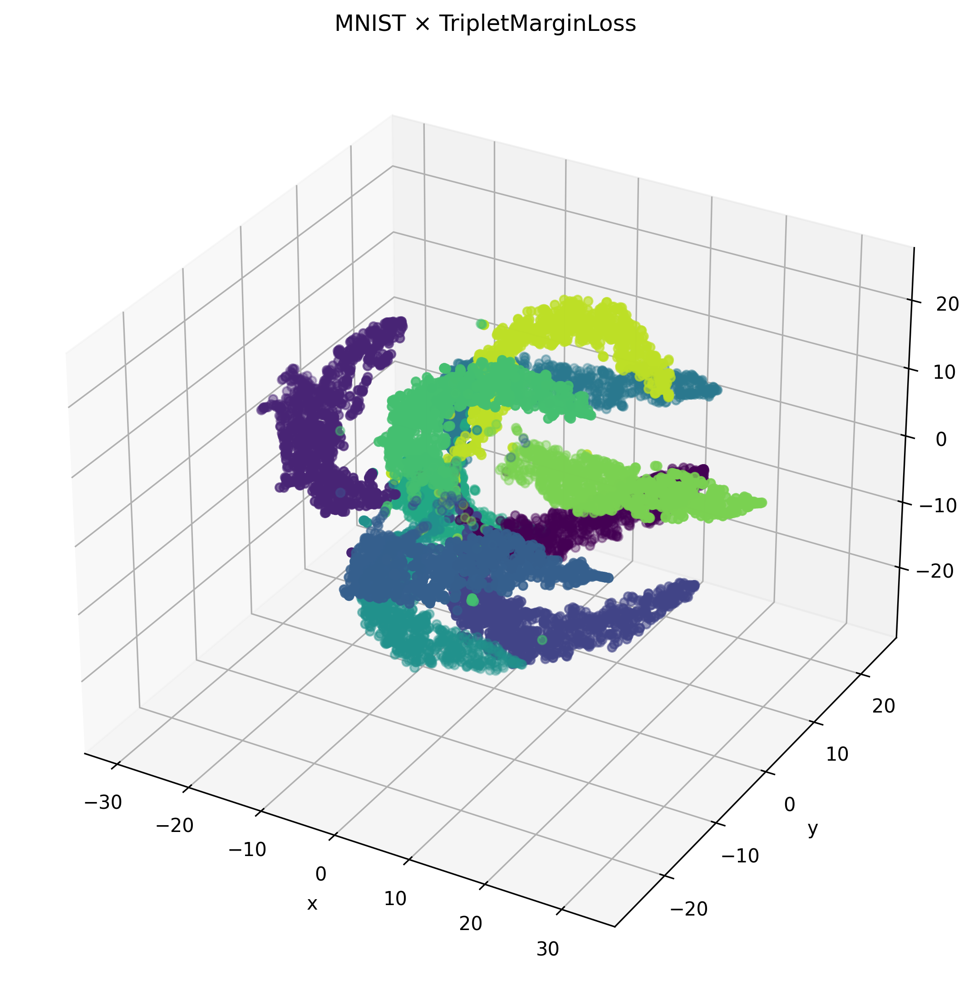

In [ ]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import numpy as np
import ipywidgets as widgets
from IPython.display import display

# 创建一个三维的图形对象，并设置标题和坐标轴标签
fig = plt.figure(figsize=(12, 9), dpi=300)
ax = fig.add_subplot(111, projection='3d')
ax.set_title('MNIST × TripletMarginLoss')
ax.set_xlabel('x')
ax.set_ylabel('y')
ax.set_zlabel('z')

# 定义一个色系
cmap = plt.get_cmap('viridis')

# 遍历每个类别，绘制对应颜色的散点图，并添加图例
for i in range(num_classes):
    indices = labels == i  # 找到属于该类别的索引
    x = embeddings_3d[indices, 0]  # 找到对应的x坐标
    y = embeddings_3d[indices, 1]  # 找到对应的y坐标
    z = embeddings_3d[indices, 2]  # 找到对应的z坐标
    color = np.array([cmap(float(i) / num_classes)])  # 将颜色值封装为数组
    ax.scatter(x, y, z, c=color, label=str(i))  # 绘制散点图，并设置颜色和标签

# 创建一个输出小部件
output_widget = widgets.Output()

# 显示图像
with output_widget:
    display(fig)

# 创建一个控制旋转的小部件
rotation_slider = widgets.FloatSlider(min=-180, max=180, value=0, description='Rotation')

# 定义一个函数来更新图像的旋转角度
def update_rotation_angle(change):
    angle = change.new
    ax.view_init(elev=30, azim=angle)
    with output_widget:
        output_widget.clear_output(wait=True)
        display(fig)

# 将更新函数绑定到旋转小部件的值变化事件
rotation_slider.observe(update_rotation_angle, 'value')

# 创建一个垂直布局小部件来显示图像和旋转控制
vbox = widgets.VBox([output_widget, rotation_slider])

# 显示垂直布局小部件
display(vbox)


## CIFAR-10 Dataset

### ArcFace

In [ ]:
import torch
import torchvision
import numpy as np
import pytorch_metric_learning
from pytorch_metric_learning import losses
from torchvision import transforms, datasets
import torch.nn as nn
import torch.optim as optim

# 超参数
batch_size = 32
learning_rate = 0.05
num_epochs = 10
num_classes = 10 # MNIST有10个类别
embedding_size = 512 # 假设你的网络输出512维的嵌入向量
margin = 28.6 # 这是论文中推荐的值
scale = 64 # 这也是论文中推荐的值

# 定义一个数据转换器，包含上述函数和其他操作
transform = transforms.Compose([
    transforms.ToTensor(), # 将图像转换为张量，并将数值范围从[0,255]变为[0,1]
    transforms.Resize((32, 32)), # 将图像大小调整为32x32
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)) # 将图像归一化，使其数值范围为[-1,1]
])

# 加载CIFAR10数据集，并应用上述转换器
train_dataset = datasets.CIFAR10(root='./data', train=True, download=True, transform=transform)
test_dataset = datasets.CIFAR10(root='./data', train=False, download=True, transform=transform)

# 创建数据加载器，用于分批加载数据
train_loader = torch.utils.data.DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
test_loader = torch.utils.data.DataLoader(test_dataset, batch_size=batch_size, shuffle=False)

# 获取预训练的ResNet-18模型
model = torchvision.models.resnet18(pretrained=False)

# 修改最后一层全连接层的输出特征数为embedding_size
num_features = model.fc.in_features # 获取全连接层的输入特征数
model.fc = nn.Linear(num_features, embedding_size) # 创建一个新的全连接层，并替换原来的全连接层

# 如果有GPU可用，则将模型移动到GPU上
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
model.to(device)

# 创建一个ArcFaceLoss对象，并传入相应的参数
loss_func = losses.ArcFaceLoss(num_classes=num_classes, embedding_size=embedding_size, margin=margin, scale=scale)

# 创建一个优化器，并将ArcFaceLoss对象的参数传递给它
optimizer = optim.SGD(list(model.parameters()) + list(loss_func.parameters()), lr=learning_rate)

# 编写训练和测试的循环，用于迭代地更新模型和损失函数的参数，并评估模型的性能
for epoch in range(num_epochs):
    # 训练阶段
    model.train() # 设置模型为训练模式
    train_loss = 0.0 # 初始化训练损失
    for data, labels in train_loader: # 遍历训练数据
        data = data.to(device) # 将图像移动到设备上
        labels = labels.to(device) # 将标签移动到设备上
        optimizer.zero_grad() # 清空梯度缓存
        embeddings = model(data) # 通过模型得到嵌入向量
        loss = loss_func(embeddings, labels) # 通过损失函数计算损失值
        loss.backward() # 反向传播计算梯度
        optimizer.step() # 更新参数
        train_loss += loss.item() * data.size(0) # 累加训练损失

    # 测试阶段
    model.eval() # 设置模型为评估模式
    test_loss = 0.0 # 初始化测试损失
    test_acc = 0.0 # 初始化测试准确率
    with torch.no_grad(): # 不计算梯度，节省内存和时间
        for data, labels in test_loader: # 遍历测试数据
            data = data.to(device) # 将图像移动到设备上
            labels = labels.to(device) # 将标签移动到设备上
            embeddings = model(data) # 通过模型得到嵌入向量
            loss = loss_func(embeddings, labels) # 通过损失函数计算损失值
            test_loss += loss.item() * data.size(0) # 累加测试损失
            logits = loss_func.get_logits(embeddings) # 通过损失函数得到分类的logits
            preds = torch.argmax(logits, dim=1) # 得到预测的类别
            test_acc += torch.sum(preds == labels).item() # 累加正确预测的数量

    # 打印每个epoch的结果
    train_loss /= len(train_dataset) # 计算平均训练损失
    test_loss /= len(test_dataset) # 计算平均测试损失
    test_acc /= len(test_dataset) # 计算测试准确率
    print(f'Epoch {epoch+1}, Train Loss: {train_loss:.4f}, Test Loss: {test_loss:.4f}, Test Acc: {test_acc:.4f}')


Files already downloaded and verified
Files already downloaded and verified
Epoch 1, Train Loss: 25.9175, Test Loss: 22.5875, Test Acc: 0.3682
Epoch 2, Train Loss: 17.5597, Test Loss: 13.0689, Test Acc: 0.4788
Epoch 3, Train Loss: 13.2992, Test Loss: 14.5991, Test Acc: 0.5130
Epoch 4, Train Loss: 14.2565, Test Loss: 13.6602, Test Acc: 0.6084
Epoch 5, Train Loss: 13.5932, Test Loss: 13.0461, Test Acc: 0.6477
Epoch 6, Train Loss: 13.1647, Test Loss: 12.7051, Test Acc: 0.6682
Epoch 7, Train Loss: 12.8012, Test Loss: 13.2911, Test Acc: 0.6917
Epoch 8, Train Loss: 12.4869, Test Loss: 13.5614, Test Acc: 0.6982
Epoch 9, Train Loss: 12.1954, Test Loss: 12.5374, Test Acc: 0.7156
Epoch 10, Train Loss: 11.9198, Test Loss: 12.1838, Test Acc: 0.7079


In [ ]:
# 导入matplotlib.pyplot和其他必要的库
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import numpy as np
from sklearn.manifold import TSNE

# 假设你的模型已经训练好了，并且保存在model变量中
# 假设你的测试数据集已经加载好了，并且保存在test_loader变量中

# 创建一个空的列表，用于存储嵌入向量和标签
embeddings = []
labels = []

# 遍历测试数据集，通过模型得到嵌入向量，并将它们和标签添加到列表中
with torch.no_grad(): # 不计算梯度，节省内存和时间
    for data, label in test_loader: # 遍历测试数据
        data = data.to(device) # 将图像移动到设备上
        label = label.to(device) # 将标签移动到设备上
        embedding = model(data) # 通过模型得到嵌入向量
        embeddings.append(embedding) # 将嵌入向量添加到列表中
        labels.append(label) # 将标签添加到列表中

# 将列表转换为numpy数组，并将嵌入向量的维度降为2或3，用于可视化
embeddings = torch.cat(embeddings, dim=0).cpu().numpy() # 将嵌入向量拼接起来，并转换为numpy数组
labels = torch.cat(labels, dim=0).cpu().numpy() # 将标签拼接起来，并转换为numpy数组
tsne = TSNE(n_components=3, perplexity=30, n_iter=1000) # 创建一个TSNE对象，并设置参数
embeddings_3d = tsne.fit_transform(embeddings) # 使用TSNE对象对嵌入向量进行降维，得到三维的坐标

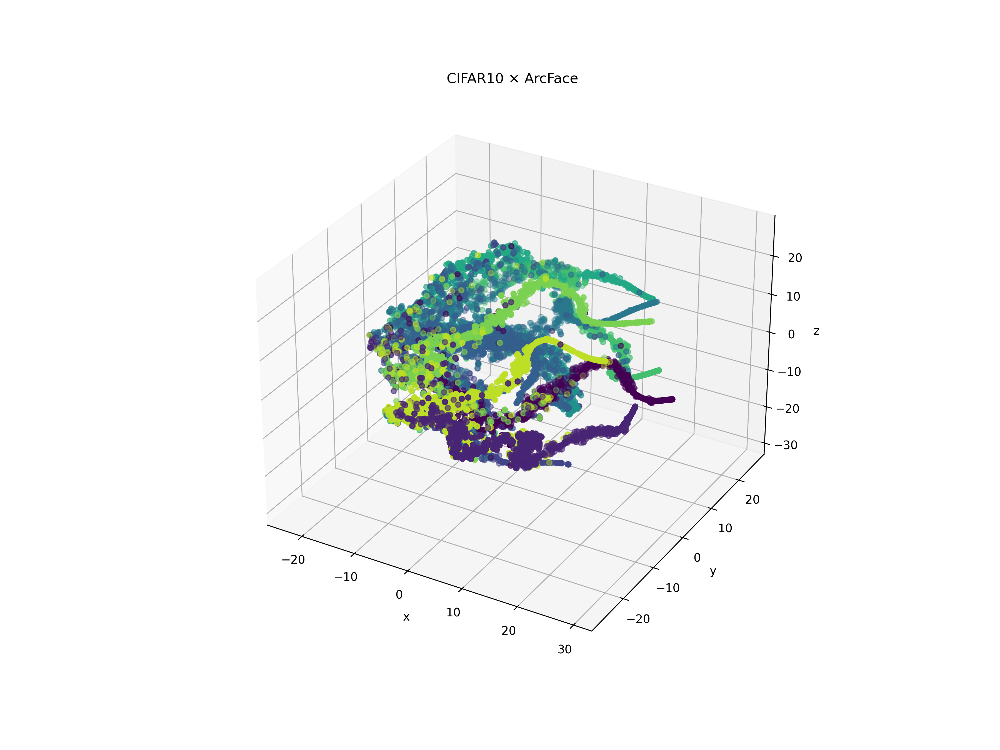

In [ ]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import numpy as np
import ipywidgets as widgets
from IPython.display import display

# 创建一个三维的图形对象，并设置标题和坐标轴标签
fig = plt.figure(figsize=(12, 9), dpi=300)
ax = fig.add_subplot(111, projection='3d')
ax.set_title('CIFAR10 × ArcFace')
ax.set_xlabel('x')
ax.set_ylabel('y')
ax.set_zlabel('z')

# 定义一个色系
cmap = plt.get_cmap('viridis')

# 遍历每个类别，绘制对应颜色的散点图，并添加图例
for i in range(num_classes):
    indices = labels == i  # 找到属于该类别的索引
    x = embeddings_3d[indices, 0]  # 找到对应的x坐标
    y = embeddings_3d[indices, 1]  # 找到对应的y坐标
    z = embeddings_3d[indices, 2]  # 找到对应的z坐标
    color = np.array([cmap(float(i) / num_classes)])  # 将颜色值封装为数组
    ax.scatter(x, y, z, c=color, label=str(i))  # 绘制散点图，并设置颜色和标签

# 创建一个输出小部件
output_widget = widgets.Output()

# 显示图像
with output_widget:
    display(fig)

# 创建一个控制旋转的小部件
rotation_slider = widgets.FloatSlider(min=-180, max=180, value=0, description='Rotation')

# 定义一个函数来更新图像的旋转角度
def update_rotation_angle(change):
    angle = change.new
    ax.view_init(elev=30, azim=angle)
    with output_widget:
        output_widget.clear_output(wait=True)
        display(fig)

# 将更新函数绑定到旋转小部件的值变化事件
rotation_slider.observe(update_rotation_angle, 'value')

# 创建一个垂直布局小部件来显示图像和旋转控制
vbox = widgets.VBox([output_widget, rotation_slider])

# 显示垂直布局小部件
display(vbox)


### CosFace

In [ ]:
import torch
import torchvision
import numpy as np
import pytorch_metric_learning
from pytorch_metric_learning import losses
from torchvision import transforms, datasets
import torch.nn as nn
import torch.optim as optim

# 超参数
batch_size = 32
learning_rate = 0.05
num_epochs = 10
num_classes = 10 # MNIST有10个类别
embedding_size = 512 # 假设你的网络输出512维的嵌入向量
margin = 28.6 # 这是论文中推荐的值
scale = 64 # 这也是论文中推荐的值

# 定义一个数据转换器，包含上述函数和其他操作
transform = transforms.Compose([
    transforms.ToTensor(), # 将图像转换为张量，并将数值范围从[0,255]变为[0,1]
    transforms.Resize((32, 32)), # 将图像大小调整为32x32
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)) # 将图像归一化，使其数值范围为[-1,1]
])

# 加载CIFAR10数据集，并应用上述转换器
train_dataset = datasets.CIFAR10(root='./data', train=True, download=True, transform=transform)
test_dataset = datasets.CIFAR10(root='./data', train=False, download=True, transform=transform)

# 创建数据加载器，用于分批加载数据
train_loader = torch.utils.data.DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
test_loader = torch.utils.data.DataLoader(test_dataset, batch_size=batch_size, shuffle=False)

# 获取预训练的ResNet-18模型
model = torchvision.models.resnet18(pretrained=False)

# 修改最后一层全连接层的输出特征数为embedding_size
num_features = model.fc.in_features # 获取全连接层的输入特征数
model.fc = nn.Linear(num_features, embedding_size) # 创建一个新的全连接层，并替换原来的全连接层

# 如果有GPU可用，则将模型移动到GPU上
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
model.to(device)

# 创建一个CosFaceLoss对象，并传入相应的参数
loss_func = losses.CosFaceLoss(num_classes=num_classes, embedding_size=embedding_size, margin=margin, scale=scale)

# 创建一个优化器，并将CosFaceLoss对象的参数传递给它
optimizer = optim.SGD(list(model.parameters()) + list(loss_func.parameters()), lr=learning_rate)

# 编写训练和测试的循环，用于迭代地更新模型和损失函数的参数，并评估模型的性能
for epoch in range(num_epochs):
    # 训练阶段
    model.train() # 设置模型为训练模式
    train_loss = 0.0 # 初始化训练损失
    for data, labels in train_loader: # 遍历训练数据
        data = data.to(device) # 将图像移动到设备上
        labels = labels.to(device) # 将标签移动到设备上
        optimizer.zero_grad() # 清空梯度缓存
        embeddings = model(data) # 通过模型得到嵌入向量
        loss = loss_func(embeddings, labels) # 通过损失函数计算损失值
        loss.backward() # 反向传播计算梯度
        optimizer.step() # 更新参数
        train_loss += loss.item() * data.size(0) # 累加训练损失

    # 测试阶段
    model.eval() # 设置模型为评估模式
    test_loss = 0.0 # 初始化测试损失
    test_acc = 0.0 # 初始化测试准确率
    with torch.no_grad(): # 不计算梯度，节省内存和时间
        for data, labels in test_loader: # 遍历测试数据
            data = data.to(device) # 将图像移动到设备上
            labels = labels.to(device) # 将标签移动到设备上
            embeddings = model(data) # 通过模型得到嵌入向量
            loss = loss_func(embeddings, labels) # 通过损失函数计算损失值
            test_loss += loss.item() * data.size(0) # 累加测试损失
            logits = loss_func.get_logits(embeddings) # 通过损失函数得到分类的logits
            preds = torch.argmax(logits, dim=1) # 得到预测的类别
            test_acc += torch.sum(preds == labels).item() # 累加正确预测的数量

    # 打印每个epoch的结果
    train_loss /= len(train_dataset) # 计算平均训练损失
    test_loss /= len(test_dataset) # 计算平均测试损失
    test_acc /= len(test_dataset) # 计算测试准确率
    print(f'Epoch {epoch+1}, Train Loss: {train_loss:.4f}, Test Loss: {test_loss:.4f}, Test Acc: {test_acc:.4f}')


Files already downloaded and verified
Files already downloaded and verified


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=None`.
  warnings.warn(msg)
/usr/local/lib/python3.10/dist-packages/torchvision/transforms/functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialia

Epoch 1, Train Loss: 1830.7948, Test Loss: 1832.3499, Test Acc: 0.3578
Epoch 2, Train Loss: 1824.0452, Test Loss: 1821.1263, Test Acc: 0.4934
Epoch 3, Train Loss: 1820.1437, Test Loss: 1819.3108, Test Acc: 0.5183
Epoch 4, Train Loss: 1817.3162, Test Loss: 1814.6183, Test Acc: 0.5552
Epoch 5, Train Loss: 1815.0260, Test Loss: 1813.7290, Test Acc: 0.5759
Epoch 6, Train Loss: 1812.5105, Test Loss: 1811.7847, Test Acc: 0.5811
Epoch 7, Train Loss: 1810.3227, Test Loss: 1809.6334, Test Acc: 0.6021
Epoch 8, Train Loss: 1808.8015, Test Loss: 1809.2351, Test Acc: 0.6073
Epoch 9, Train Loss: 1807.3050, Test Loss: 1806.8830, Test Acc: 0.6266
Epoch 10, Train Loss: 1806.0618, Test Loss: 1805.1597, Test Acc: 0.6470


In [ ]:
# 导入matplotlib.pyplot和其他必要的库
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import numpy as np
from sklearn.manifold import TSNE

# 假设你的模型已经训练好了，并且保存在model变量中
# 假设你的测试数据集已经加载好了，并且保存在test_loader变量中

# 创建一个空的列表，用于存储嵌入向量和标签
embeddings = []
labels = []

# 遍历测试数据集，通过模型得到嵌入向量，并将它们和标签添加到列表中
with torch.no_grad(): # 不计算梯度，节省内存和时间
    for data, label in test_loader: # 遍历测试数据
        data = data.to(device) # 将图像移动到设备上
        label = label.to(device) # 将标签移动到设备上
        embedding = model(data) # 通过模型得到嵌入向量
        embeddings.append(embedding) # 将嵌入向量添加到列表中
        labels.append(label) # 将标签添加到列表中

# 将列表转换为numpy数组，并将嵌入向量的维度降为2或3，用于可视化
embeddings = torch.cat(embeddings, dim=0).cpu().numpy() # 将嵌入向量拼接起来，并转换为numpy数组
labels = torch.cat(labels, dim=0).cpu().numpy() # 将标签拼接起来，并转换为numpy数组
tsne = TSNE(n_components=3, perplexity=30, n_iter=1000) # 创建一个TSNE对象，并设置参数
embeddings_3d = tsne.fit_transform(embeddings) # 使用TSNE对象对嵌入向量进行降维，得到三维的坐标

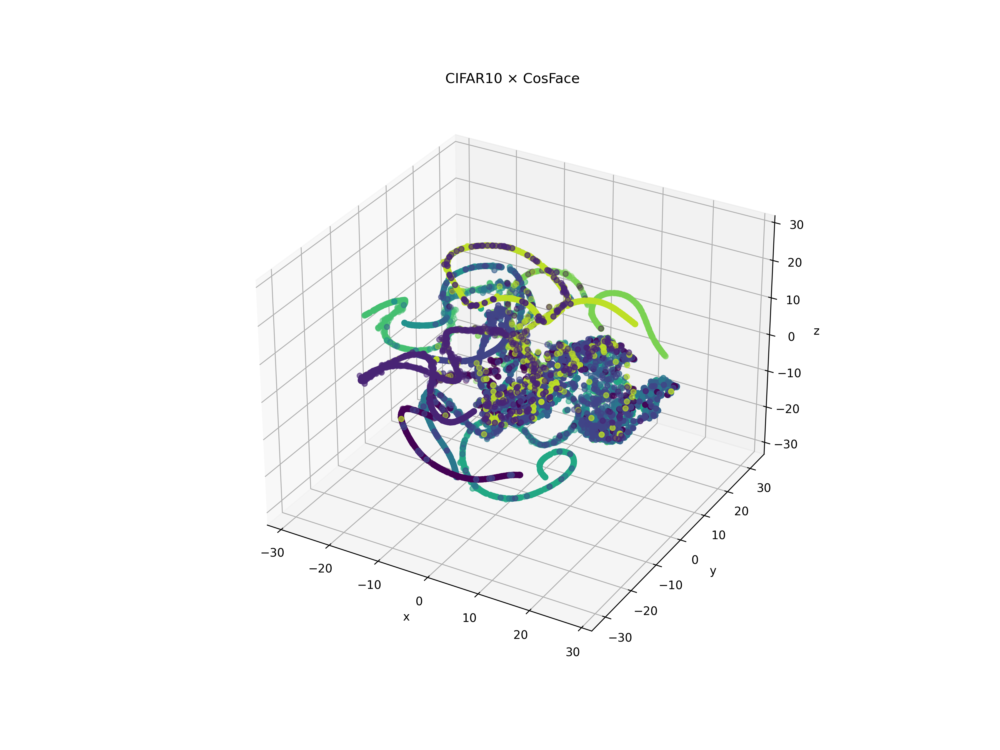

In [ ]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import numpy as np
import ipywidgets as widgets
from IPython.display import display

# 创建一个三维的图形对象，并设置标题和坐标轴标签
fig = plt.figure(figsize=(12, 9), dpi=300)
ax = fig.add_subplot(111, projection='3d')
ax.set_title('CIFAR10 × CosFace')
ax.set_xlabel('x')
ax.set_ylabel('y')
ax.set_zlabel('z')

# 定义一个色系
cmap = plt.get_cmap('viridis')

# 遍历每个类别，绘制对应颜色的散点图，并添加图例
for i in range(num_classes):
    indices = labels == i  # 找到属于该类别的索引
    x = embeddings_3d[indices, 0]  # 找到对应的x坐标
    y = embeddings_3d[indices, 1]  # 找到对应的y坐标
    z = embeddings_3d[indices, 2]  # 找到对应的z坐标
    color = np.array([cmap(float(i) / num_classes)])  # 将颜色值封装为数组
    ax.scatter(x, y, z, c=color, label=str(i))  # 绘制散点图，并设置颜色和标签

# 创建一个输出小部件
output_widget = widgets.Output()

# 显示图像
with output_widget:
    display(fig)

# 创建一个控制旋转的小部件
rotation_slider = widgets.FloatSlider(min=-180, max=180, value=0, description='Rotation')

# 定义一个函数来更新图像的旋转角度
def update_rotation_angle(change):
    angle = change.new
    ax.view_init(elev=30, azim=angle)
    with output_widget:
        output_widget.clear_output(wait=True)
        display(fig)

# 将更新函数绑定到旋转小部件的值变化事件
rotation_slider.observe(update_rotation_angle, 'value')

# 创建一个垂直布局小部件来显示图像和旋转控制
vbox = widgets.VBox([output_widget, rotation_slider])

# 显示垂直布局小部件
display(vbox)


### TripletMarginLoss

In [ ]:
from pytorch_metric_learning import miners
import torch
import torchvision
import numpy as np
import pytorch_metric_learning
from pytorch_metric_learning import losses
from torchvision import transforms, datasets
import torch.nn as nn
import torch.optim as optim
from tqdm import tqdm

# 创建一个 MultiSimilarityMiner 对象
miner = miners.MultiSimilarityMiner()


# 超参数
batch_size = 32
learning_rate = 0.05
num_epochs = 10
num_classes = 10 # MNIST有10个类别
embedding_size = 512 # 假设你的网络输出512维的嵌入向量
margin = 28.6 # 这是论文中推荐的值
scale = 64 # 这也是论文中推荐的值

# 定义一个数据转换器，包含上述函数和其他操作
transform = transforms.Compose([
    transforms.ToTensor(), # 将图像转换为张量，并将数值范围从[0,255]变为[0,1]
    transforms.Resize((32, 32)), # 将图像大小调整为32x32
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)) # 将图像归一化，使其数值范围为[-1,1]
])

# 加载CIFAR10数据集，并应用上述转换器
train_dataset = datasets.CIFAR10(root='./data', train=True, download=True, transform=transform)
test_dataset = datasets.CIFAR10(root='./data', train=False, download=True, transform=transform)

# 创建数据加载器，用于分批加载数据
train_loader = torch.utils.data.DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
test_loader = torch.utils.data.DataLoader(test_dataset, batch_size=batch_size, shuffle=False)

# 获取预训练的ResNet-18模型
model = torchvision.models.resnet18(pretrained=False)

# 修改最后一层全连接层的输出特征数为embedding_size
num_features = model.fc.in_features # 获取全连接层的输入特征数
model.fc = nn.Sequential(
    nn.Linear(num_features, embedding_size),
    nn.ReLU(),
    nn.Linear(embedding_size, num_classes)
)

# 如果有GPU可用，则将模型移动到GPU上
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
model.to(device)

# 创建一个 TripletMarginLoss 对象
loss_func = losses.TripletMarginLoss(margin=0.05)

# 创建一个优化器，并将TripletMarginLoss对象的参数传递给它
optimizer = optim.SGD(list(model.parameters()) + list(loss_func.parameters()), lr=learning_rate)

for epoch in range(num_epochs):
    # 训练阶段
    model.train()
    train_loss = 0.0
    for data, labels in tqdm(train_loader, desc="Training"):
        data = data.to(device)
        labels = labels.to(device)
        optimizer.zero_grad()
        embeddings = model(data)
        
        # 调用 miner 得到 indices_tuple
        indices_tuple = miner(embeddings, labels)
        
        # 将 embeddings 和 indices_tuple 传入 loss_func
        loss = loss_func(embeddings, labels, indices_tuple)
        
        loss.backward()
        optimizer.step()
        train_loss += loss.item() * data.size(0)

    # 测试阶段
    model.eval()
    test_loss = 0.0
    test_acc = 0.0
    with torch.no_grad():
        for data, labels in tqdm(test_loader, desc="Testing"):
            data = data.to(device)
            labels = labels.to(device)
            outputs = model(data) # 使用模型的输出作为预测结果
            embeddings = outputs[:, :-num_classes] # 获取嵌入向量
            
            indices_tuple = miner(embeddings, labels)
            
            loss = loss_func(embeddings, labels, indices_tuple)
            
            test_loss += loss.item() * data.size(0)
            preds = torch.argmax(outputs, dim=1) # 使用模型的输出来获取预测的类别
            test_acc += torch.sum(preds == labels).item()

    train_loss /= len(train_dataset)
    test_loss /= len(test_dataset)
    test_acc /= len(test_dataset)
    print(f'Epoch {epoch+1}, Train Loss: {train_loss:.4f}, Test Loss: {test_loss:.4f}, Test Acc: {test_acc:.4f}')


100%|██████████| 170498071/170498071 [00:05<00:00, 29636154.79it/s]


Extracting ./data/cifar-10-python.tar.gz to ./data
Files already downloaded and verified


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=None`.
  warnings.warn(msg)
Training:   0%|          | 0/1563 [00:00<?, ?it/s]/usr/local/lib/python3.10/dist-packages/torchvision/transforms/functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which mean

Epoch 1, Train Loss: 0.0542, Test Loss: 0.0500, Test Acc: 0.1000


Testing: 100%|██████████| 313/313 [00:06<00:00, 48.88it/s]


Epoch 2, Train Loss: 0.0508, Test Loss: 0.0500, Test Acc: 0.1000


Testing: 100%|██████████| 313/313 [00:06<00:00, 48.33it/s]


Epoch 3, Train Loss: 0.0505, Test Loss: 0.0500, Test Acc: 0.1000


Testing: 100%|██████████| 313/313 [00:06<00:00, 48.58it/s]


Epoch 4, Train Loss: 0.0503, Test Loss: 0.0500, Test Acc: 0.1000


Testing: 100%|██████████| 313/313 [00:06<00:00, 48.90it/s]


Epoch 5, Train Loss: 0.0504, Test Loss: 0.0500, Test Acc: 0.1000


Testing: 100%|██████████| 313/313 [00:06<00:00, 49.44it/s]


Epoch 6, Train Loss: 0.0503, Test Loss: 0.0500, Test Acc: 0.1000


Testing: 100%|██████████| 313/313 [00:06<00:00, 49.90it/s]


Epoch 7, Train Loss: 0.0502, Test Loss: 0.0500, Test Acc: 0.1000


Testing: 100%|██████████| 313/313 [00:06<00:00, 48.38it/s]


Epoch 8, Train Loss: 0.0502, Test Loss: 0.0500, Test Acc: 0.1000


Testing: 100%|██████████| 313/313 [00:06<00:00, 49.30it/s]


Epoch 9, Train Loss: 0.0503, Test Loss: 0.0500, Test Acc: 0.1000


Testing: 100%|██████████| 313/313 [00:06<00:00, 49.53it/s]

Epoch 10, Train Loss: 0.0502, Test Loss: 0.0500, Test Acc: 0.1000


In [ ]:
# 导入matplotlib.pyplot和其他必要的库
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import numpy as np
from sklearn.manifold import TSNE

# 假设你的模型已经训练好了，并且保存在model变量中
# 假设你的测试数据集已经加载好了，并且保存在test_loader变量中

# 创建一个空的列表，用于存储嵌入向量和标签
embeddings = []
labels = []

# 遍历测试数据集，通过模型得到嵌入向量，并将它们和标签添加到列表中
with torch.no_grad(): # 不计算梯度，节省内存和时间
    for data, label in test_loader: # 遍历测试数据
        data = data.to(device) # 将图像移动到设备上
        label = label.to(device) # 将标签移动到设备上
        embedding = model(data) # 通过模型得到嵌入向量
        embeddings.append(embedding) # 将嵌入向量添加到列表中
        labels.append(label) # 将标签添加到列表中

# 将列表转换为numpy数组，并将嵌入向量的维度降为2或3，用于可视化
embeddings = torch.cat(embeddings, dim=0).cpu().numpy() # 将嵌入向量拼接起来，并转换为numpy数组
labels = torch.cat(labels, dim=0).cpu().numpy() # 将标签拼接起来，并转换为numpy数组
tsne = TSNE(n_components=3, perplexity=30, n_iter=1000) # 创建一个TSNE对象，并设置参数
embeddings_3d = tsne.fit_transform(embeddings) # 使用TSNE对象对嵌入向量进行降维，得到三维的坐标

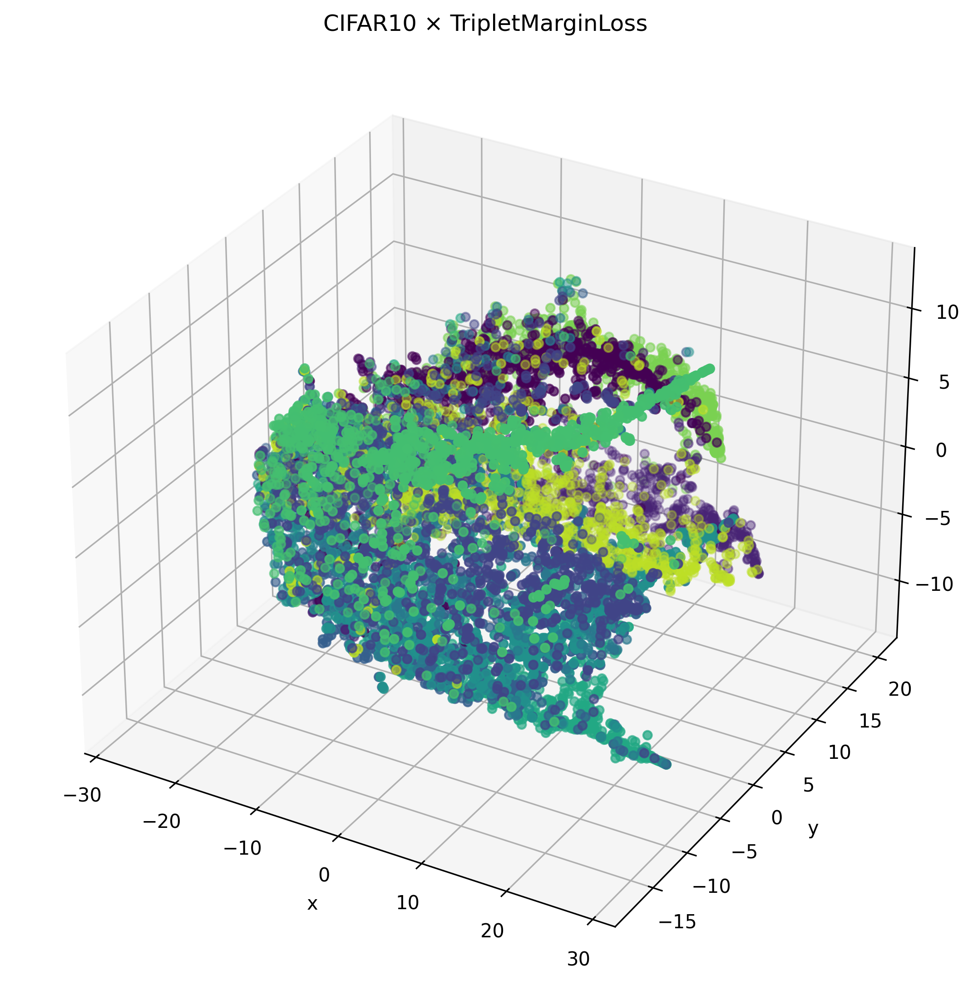

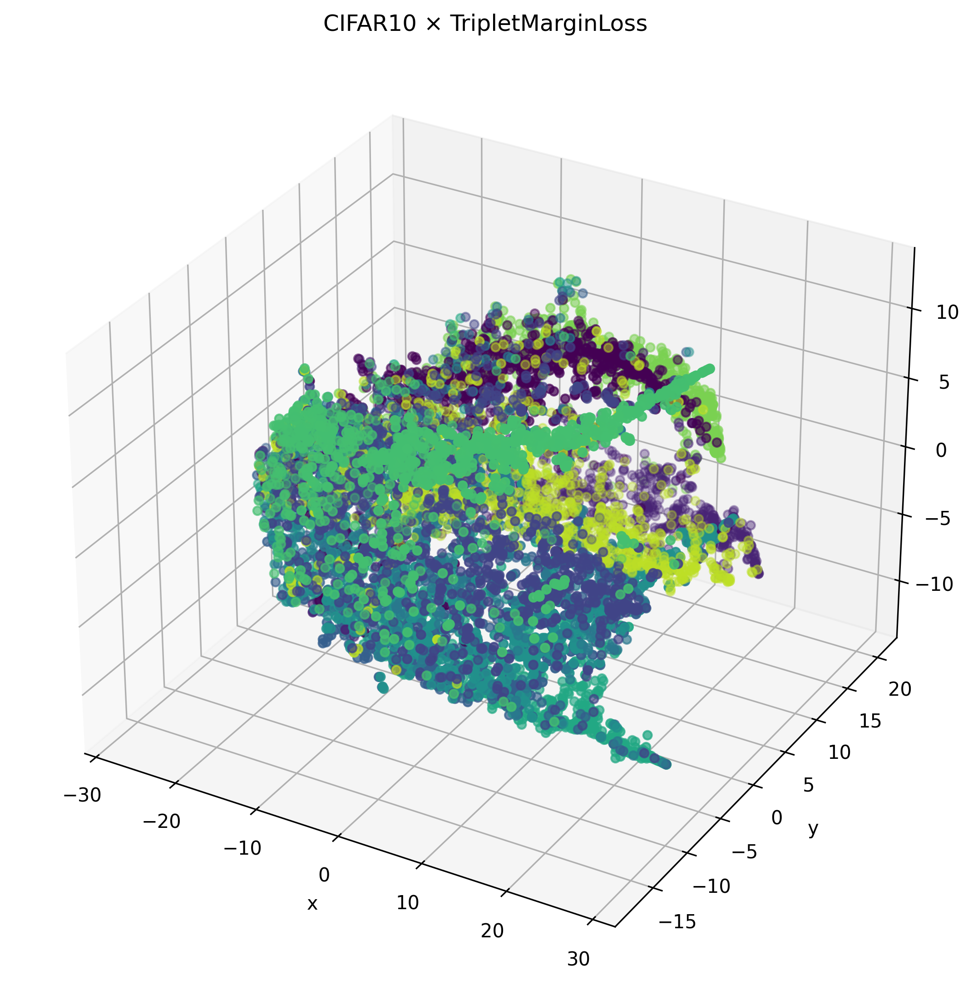

In [ ]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import numpy as np
import ipywidgets as widgets
from IPython.display import display

# 创建一个三维的图形对象，并设置标题和坐标轴标签
fig = plt.figure(figsize=(12, 9), dpi=300)
ax = fig.add_subplot(111, projection='3d')
ax.set_title('CIFAR10 × TripletMarginLoss')
ax.set_xlabel('x')
ax.set_ylabel('y')
ax.set_zlabel('z')

# 定义一个色系
cmap = plt.get_cmap('viridis')

# 遍历每个类别，绘制对应颜色的散点图，并添加图例
for i in range(num_classes):
    indices = labels == i  # 找到属于该类别的索引
    x = embeddings_3d[indices, 0]  # 找到对应的x坐标
    y = embeddings_3d[indices, 1]  # 找到对应的y坐标
    z = embeddings_3d[indices, 2]  # 找到对应的z坐标
    color = np.array([cmap(float(i) / num_classes)])  # 将颜色值封装为数组
    ax.scatter(x, y, z, c=color, label=str(i))  # 绘制散点图，并设置颜色和标签

# 创建一个输出小部件
output_widget = widgets.Output()

# 显示图像
with output_widget:
    display(fig)

# 创建一个控制旋转的小部件
rotation_slider = widgets.FloatSlider(min=-180, max=180, value=0, description='Rotation')

# 定义一个函数来更新图像的旋转角度
def update_rotation_angle(change):
    angle = change.new
    ax.view_init(elev=30, azim=angle)
    with output_widget:
        output_widget.clear_output(wait=True)
        display(fig)

# 将更新函数绑定到旋转小部件的值变化事件
rotation_slider.observe(update_rotation_angle, 'value')

# 创建一个垂直布局小部件来显示图像和旋转控制
vbox = widgets.VBox([output_widget, rotation_slider])

# 显示垂直布局小部件
display(vbox)


## Omniglot Dataset

### ArcFace

In [ ]:
import torch
import torchvision
import numpy as np
import pytorch_metric_learning
from pytorch_metric_learning import losses
from torchvision import transforms, datasets
import torch.nn as nn
import torch.optim as optim
import os
from tqdm import tqdm

# 超参数
batch_size = 256
learning_rate = 0.01
num_epochs = 10
num_classes = 5749 # LFWPeople有5749个类别
embedding_size = 512 # 假设你的网络输出512维的嵌入向量
margin = 28.6 # 这是论文中推荐的值
scale = 64 # 这也是论文中推荐的值


# 定义一个数据转换器，包含上述函数和其他操作
transform = transforms.Compose([
    transforms.ToTensor(), # 将图像转换为张量，并将数值范围从[0,255]变为[0,1]
    transforms.Resize((32, 32)), # 将图像大小调整为32x32
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)) # 将图像归一化，使其数值范围为[-1,1]
])

# 加载数据集，并应用上述转换器
train_dataset = datasets.lfw.LFWPeople(root='data', image_set='funneled', transform=transform, download=True)
test_dataset = datasets.lfw.LFWPeople(root='data', image_set='funneled', transform=transform, split='test', download=True)

# 创建数据加载器，用于分批加载数据
train_loader = torch.utils.data.DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
test_loader = torch.utils.data.DataLoader(test_dataset, batch_size=batch_size, shuffle=False)

# 获取预训练的ResNet-18模型
model = torchvision.models.resnet18(pretrained=True)

# 修改最后一层全连接层的输出特征数为embedding_size
num_features = model.fc.in_features # 获取全连接层的输入特征数
model.fc = nn.Linear(num_features, embedding_size) # 创建一个新的全连接层，并替换原来的全连接层

# 如果有GPU可用，则将模型移动到GPU上
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
model.to(device)

# 创建一个ArcFaceLoss对象，并传入相应的参数
loss_func = losses.ArcFaceLoss(num_classes=num_classes, embedding_size=embedding_size, margin=margin, scale=scale)

# 创建一个优化器，并将ArcFaceLoss对象的参数传递给它
optimizer = optim.SGD(list(model.parameters()) + list(loss_func.parameters()), lr=learning_rate)

# 编写训练和测试的循环，用于迭代地更新模型和损失函数的参数，并评估模型的性能

# 训练和测试的循环
for epoch in range(num_epochs):
    # 训练阶段
    model.train() # 设置模型为训练模式
    train_loss = 0.0 # 初始化训练损失
    progress_bar = tqdm(train_loader, desc=f'Epoch {epoch+1}, Train Loss: {train_loss:.4f}', leave=False)
    for data, labels in progress_bar: # 遍历训练数据
        data = data.to(device) # 将图像移动到设备上
        labels = labels.to(device) # 将标签移动到设备上
        optimizer.zero_grad() # 清空梯度缓存
        embeddings = model(data) # 通过模型得到嵌入向量
        loss = loss_func(embeddings, labels) # 通过损失函数计算损失值
        loss.backward(retain_graph=True) # 反向传播计算梯度，保留计算图
        optimizer.step() # 更新参数
        train_loss += loss.item() * data.size(0) # 累加训练损失
        progress_bar.set_description(f'Epoch {epoch+1}, Train Loss: {train_loss / len(train_dataset):.4f}')

    # 测试阶段
    model.eval() # 设置模型为评估模式
    test_loss = 0.0 # 初始化测试损失
    test_acc = 0.0 # 初始化测试准确率
    with torch.no_grad(): # 不计算梯度，节省内存和时间
        progress_bar = tqdm(test_loader, desc='Testing', leave=False)
        for data, labels in progress_bar: # 遍历测试数据
            data = data.to(device) # 将图像移动到设备上
            labels = labels.to(device) # 将标签移动到设备上
            embeddings = model(data) # 通过模型得到嵌入向量
            loss = loss_func(embeddings, labels) # 通过损失函数计算损失值
            test_loss += loss.item() * data.size(0) # 累加测试损失
            logits = loss_func.get_logits(embeddings) # 通过损失函数得到分类的logits
            preds = torch.argmax(logits, dim=1) # 得到预测的类别
            test_acc += torch.eq(preds, labels).sum().item() # 累加正确预测的数量
            progress_bar.set_description('Testing')

    # 打印每个epoch的结果
    train_loss /= len(train_dataset) # 计算平均训练损失
    test_loss /= len(test_dataset) # 计算平均测试损失
    test_acc /= len(test_dataset) # 计算测试准确率
    print(f'Epoch {epoch+1}, Train Loss: {train_loss:.4f}, Test Loss: {test_loss:.4f}, Test Acc: {test_acc:.4f}')
print('训练完成')

Files already downloaded and verified
Files already downloaded and verified


Epoch 1, Train Loss: 41.4785, Test Loss: 40.4090, Test Acc: 0.0113


Epoch 2, Train Loss: 40.0275, Test Loss: 39.4993, Test Acc: 0.0286


Epoch 3, Train Loss: 39.2492, Test Loss: 38.5823, Test Acc: 0.0774


Epoch 4, Train Loss: 38.4033, Test Loss: 37.5360, Test Acc: 0.1448


Epoch 5, Train Loss: 37.4520, Test Loss: 36.3299, Test Acc: 0.2505


Epoch 6, Train Loss: 36.4224, Test Loss: 35.6929, Test Acc: 0.2958


Epoch 7, Train Loss: 35.4697, Test Loss: 36.0062, Test Acc: 0.2594


Epoch 8, Train Loss: 34.5524, Test Loss: 34.3548, Test Acc: 0.3954


Epoch 9, Train Loss: 33.4727, Test Loss: 33.8396, Test Acc: 0.4204


Epoch 10, Train Loss: 32.3864, Test Loss: 32.8566, Test Acc: 0.4841


/usr/local/lib/python3.10/dist-packages/torchvision/transforms/functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works on Tensors - PIL will still use antialiasing). This also applies if you are using the inference transforms from the models weights: update the call to weights.transforms(antialias=True).
  warnings.warn(


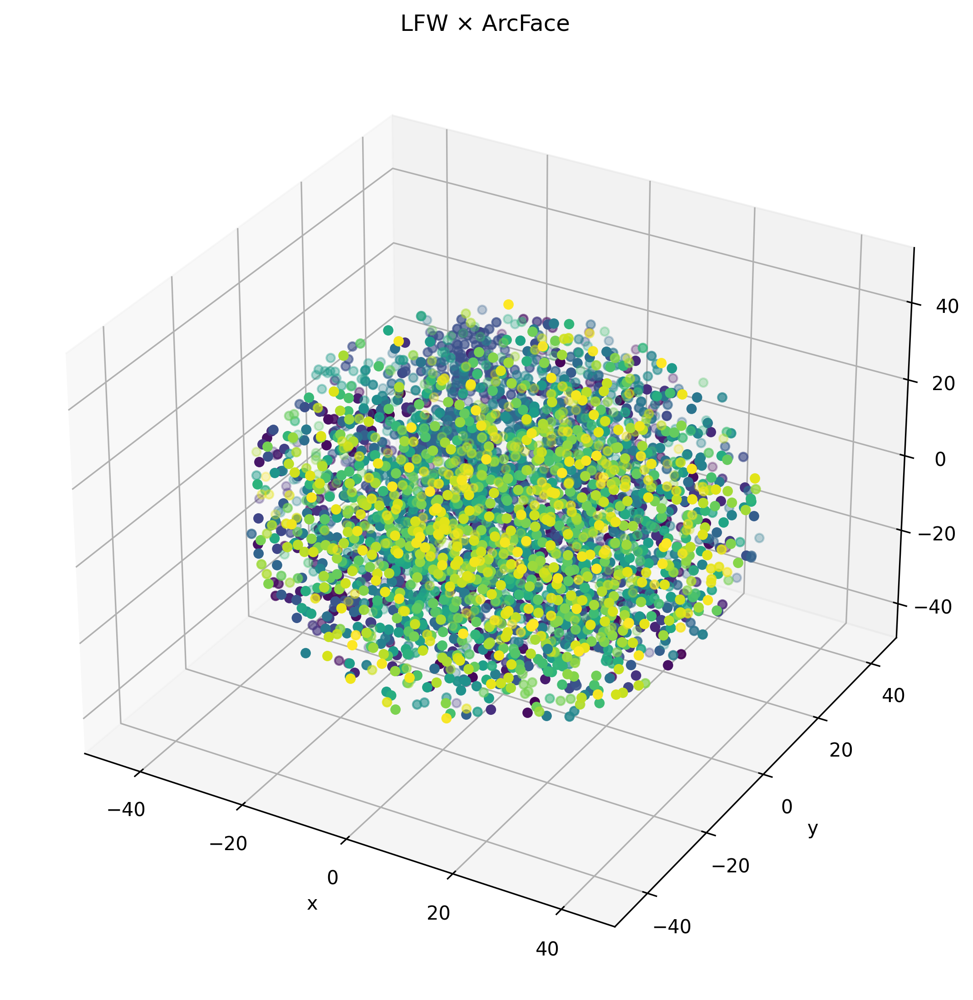

In [ ]:
# 导入matplotlib.pyplot和其他必要的库
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import numpy as np
from sklearn.manifold import TSNE

# 假设你的模型已经训练好了，并且保存在model变量中
# 假设你的测试数据集已经加载好了，并且保存在test_loader变量中

# 创建一个空的列表，用于存储嵌入向量和标签
embeddings = []
labels = []

# 遍历测试数据集，通过模型得到嵌入向量，并将它们和标签添加到列表中
with torch.no_grad(): # 不计算梯度，节省内存和时间
    for data, label in test_loader: # 遍历测试数据
        data = data.to(device) # 将图像移动到设备上
        label = label.to(device) # 将标签移动到设备上
        embedding = model(data) # 通过模型得到嵌入向量
        embeddings.append(embedding) # 将嵌入向量添加到列表中
        labels.append(label) # 将标签添加到列表中

# 将列表转换为numpy数组，并将嵌入向量的维度降为2或3，用于可视化
embeddings = torch.cat(embeddings, dim=0).cpu().numpy() # 将嵌入向量拼接起来，并转换为numpy数组
labels = torch.cat(labels, dim=0).cpu().numpy() # 将标签拼接起来，并转换为numpy数组
tsne = TSNE(n_components=3, perplexity=30, n_iter=1000) # 创建一个TSNE对象，并设置参数
embeddings_3d = tsne.fit_transform(embeddings) # 使用TSNE对象对嵌入向量进行降维，得到三维的坐标

import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import numpy as np
import ipywidgets as widgets
from IPython.display import display

# 创建一个三维的图形对象，并设置标题和坐标轴标签
fig = plt.figure(figsize=(12, 9), dpi=300)
ax = fig.add_subplot(111, projection='3d')
ax.set_title('LFW × ArcFace')
ax.set_xlabel('x')
ax.set_ylabel('y')
ax.set_zlabel('z')

# 定义一个色系
cmap = plt.get_cmap('viridis')

# 遍历每个类别，绘制对应颜色的散点图，并添加图例
for i in range(num_classes):
    indices = labels == i  # 找到属于该类别的索引
    x = embeddings_3d[indices, 0]  # 找到对应的x坐标
    y = embeddings_3d[indices, 1]  # 找到对应的y坐标
    z = embeddings_3d[indices, 2]  # 找到对应的z坐标
    color = np.array([cmap(float(i) / num_classes)])  # 将颜色值封装为数组
    ax.scatter(x, y, z, c=color, label=str(i))  # 绘制散点图，并设置颜色和标签

# 创建一个输出小部件
output_widget = widgets.Output()

# 显示图像
with output_widget:
    display(fig)

# 创建一个控制旋转的小部件
rotation_slider = widgets.FloatSlider(min=-180, max=180, value=0, description='Rotation')

# 定义一个函数来更新图像的旋转角度
def update_rotation_angle(change):
    angle = change.new
    ax.view_init(elev=30, azim=angle)
    with output_widget:
        output_widget.clear_output(wait=True)
        display(fig)

# 将更新函数绑定到旋转小部件的值变化事件
rotation_slider.observe(update_rotation_angle, 'value')

# 创建一个垂直布局小部件来显示图像和旋转控制
vbox = widgets.VBox([output_widget, rotation_slider])

# 显示垂直布局小部件
display(vbox)


### CosFace

In [ ]:
import torch
import torchvision
import numpy as np
import pytorch_metric_learning
from pytorch_metric_learning import losses
from torchvision import transforms, datasets
import torch.nn as nn
import torch.optim as optim
import os
from tqdm import tqdm

# 超参数
batch_size = 256
learning_rate = 0.01
num_epochs = 10
num_classes = 5749 # LFWPeople有5749个类别
embedding_size = 512 # 假设你的网络输出512维的嵌入向量
margin = 28.6 # 这是论文中推荐的值
scale = 64 # 这也是论文中推荐的值


# 定义一个数据转换器，包含上述函数和其他操作
transform = transforms.Compose([
    transforms.ToTensor(), # 将图像转换为张量，并将数值范围从[0,255]变为[0,1]
    transforms.Resize((32, 32)), # 将图像大小调整为32x32
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)) # 将图像归一化，使其数值范围为[-1,1]
])

# 加载数据集，并应用上述转换器
train_dataset = datasets.lfw.LFWPeople(root='data', image_set='funneled', transform=transform, download=True)
test_dataset = datasets.lfw.LFWPeople(root='data', image_set='funneled', transform=transform, split='test', download=True)

# 创建数据加载器，用于分批加载数据
train_loader = torch.utils.data.DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
test_loader = torch.utils.data.DataLoader(test_dataset, batch_size=batch_size, shuffle=False)

# 获取预训练的ResNet-18模型
model = torchvision.models.resnet18(pretrained=True)

# 修改最后一层全连接层的输出特征数为embedding_size
num_features = model.fc.in_features # 获取全连接层的输入特征数
model.fc = nn.Linear(num_features, embedding_size) # 创建一个新的全连接层，并替换原来的全连接层

# 如果有GPU可用，则将模型移动到GPU上
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
model.to(device)

# 创建一个CosFaceLoss对象，并传入相应的参数
loss_func = losses.CosFaceLoss(num_classes=num_classes, embedding_size=embedding_size, margin=margin, scale=scale)

# 创建一个优化器，并将CosFaceLoss对象的参数传递给它
optimizer = optim.SGD(list(model.parameters()) + list(loss_func.parameters()), lr=learning_rate)

# 编写训练和测试的循环，用于迭代地更新模型和损失函数的参数，并评估模型的性能

# 训练和测试的循环
for epoch in range(num_epochs):
    # 训练阶段
    model.train() # 设置模型为训练模式
    train_loss = 0.0 # 初始化训练损失
    progress_bar = tqdm(train_loader, desc=f'Epoch {epoch+1}, Train Loss: {train_loss:.4f}', leave=False)
    for data, labels in progress_bar: # 遍历训练数据
        data = data.to(device) # 将图像移动到设备上
        labels = labels.to(device) # 将标签移动到设备上
        optimizer.zero_grad() # 清空梯度缓存
        embeddings = model(data) # 通过模型得到嵌入向量
        loss = loss_func(embeddings, labels) # 通过损失函数计算损失值
        loss.backward(retain_graph=True) # 反向传播计算梯度，保留计算图
        optimizer.step() # 更新参数
        train_loss += loss.item() * data.size(0) # 累加训练损失
        progress_bar.set_description(f'Epoch {epoch+1}, Train Loss: {train_loss / len(train_dataset):.4f}')

    # 测试阶段
    model.eval() # 设置模型为评估模式
    test_loss = 0.0 # 初始化测试损失
    test_acc = 0.0 # 初始化测试准确率
    with torch.no_grad(): # 不计算梯度，节省内存和时间
        progress_bar = tqdm(test_loader, desc='Testing', leave=False)
        for data, labels in progress_bar: # 遍历测试数据
            data = data.to(device) # 将图像移动到设备上
            labels = labels.to(device) # 将标签移动到设备上
            embeddings = model(data) # 通过模型得到嵌入向量
            loss = loss_func(embeddings, labels) # 通过损失函数计算损失值
            test_loss += loss.item() * data.size(0) # 累加测试损失
            logits = loss_func.get_logits(embeddings) # 通过损失函数得到分类的logits
            preds = torch.argmax(logits, dim=1) # 得到预测的类别
            test_acc += torch.eq(preds, labels).sum().item() # 累加正确预测的数量
            progress_bar.set_description('Testing')

    # 打印每个epoch的结果
    train_loss /= len(train_dataset) # 计算平均训练损失
    test_loss /= len(test_dataset) # 计算平均测试损失
    test_acc /= len(test_dataset) # 计算测试准确率
    print(f'Epoch {epoch+1}, Train Loss: {train_loss:.4f}, Test Loss: {test_loss:.4f}, Test Acc: {test_acc:.4f}')
print('训练完成')

Files already downloaded and verified
Files already downloaded and verified


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet18_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet18_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Epoch 1, Train Loss: 0.0000:   0%|          | 0/52 [00:00<?, ?it/s]/usr/local/lib/python3.10/dist-packages/torchvision/transforms/functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends

Epoch 1, Train Loss: 1841.1492, Test Loss: 1839.9424, Test Acc: 0.0092


Epoch 2, Train Loss: 1839.4556, Test Loss: 1838.7500, Test Acc: 0.0464


Epoch 3, Train Loss: 1838.4883, Test Loss: 1837.6855, Test Acc: 0.0828


Epoch 4, Train Loss: 1837.4329, Test Loss: 1836.4918, Test Acc: 0.1610


Epoch 5, Train Loss: 1836.2526, Test Loss: 1835.3197, Test Acc: 0.2322


Epoch 6, Train Loss: 1835.1215, Test Loss: 1834.6796, Test Acc: 0.2821


Epoch 7, Train Loss: 1833.9496, Test Loss: 1833.8966, Test Acc: 0.3406


Epoch 8, Train Loss: 1832.8884, Test Loss: 1832.9205, Test Acc: 0.4342


Epoch 9, Train Loss: 1831.6073, Test Loss: 1832.6403, Test Acc: 0.4447


Epoch 10, Train Loss: 1830.4290, Test Loss: 1832.4358, Test Acc: 0.4444
训练完成


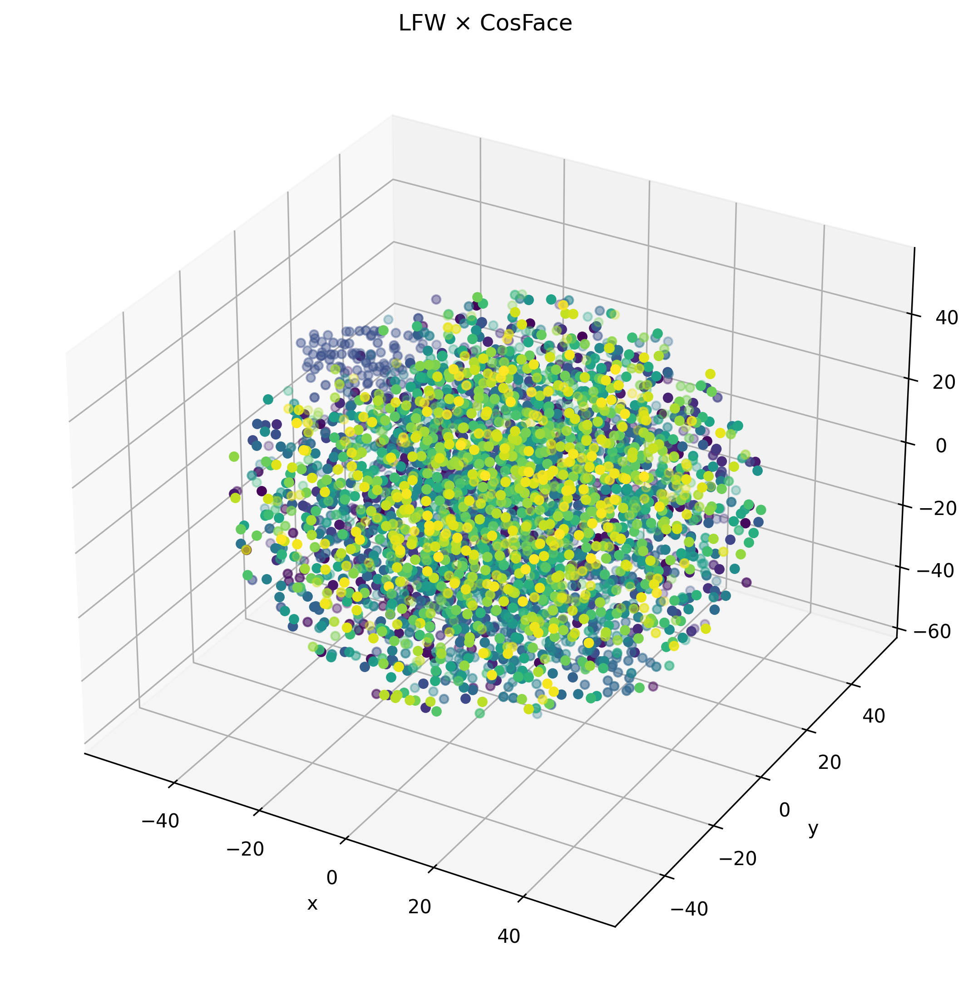

In [ ]:
# 导入matplotlib.pyplot和其他必要的库
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import numpy as np
from sklearn.manifold import TSNE

# 假设你的模型已经训练好了，并且保存在model变量中
# 假设你的测试数据集已经加载好了，并且保存在test_loader变量中

# 创建一个空的列表，用于存储嵌入向量和标签
embeddings = []
labels = []

# 遍历测试数据集，通过模型得到嵌入向量，并将它们和标签添加到列表中
with torch.no_grad(): # 不计算梯度，节省内存和时间
    for data, label in test_loader: # 遍历测试数据
        data = data.to(device) # 将图像移动到设备上
        label = label.to(device) # 将标签移动到设备上
        embedding = model(data) # 通过模型得到嵌入向量
        embeddings.append(embedding) # 将嵌入向量添加到列表中
        labels.append(label) # 将标签添加到列表中

# 将列表转换为numpy数组，并将嵌入向量的维度降为2或3，用于可视化
embeddings = torch.cat(embeddings, dim=0).cpu().numpy() # 将嵌入向量拼接起来，并转换为numpy数组
labels = torch.cat(labels, dim=0).cpu().numpy() # 将标签拼接起来，并转换为numpy数组
tsne = TSNE(n_components=3, perplexity=30, n_iter=1000) # 创建一个TSNE对象，并设置参数
embeddings_3d = tsne.fit_transform(embeddings) # 使用TSNE对象对嵌入向量进行降维，得到三维的坐标

import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import numpy as np
import ipywidgets as widgets
from IPython.display import display

# 创建一个三维的图形对象，并设置标题和坐标轴标签
fig = plt.figure(figsize=(12, 9), dpi=300)
ax = fig.add_subplot(111, projection='3d')
ax.set_title('LFW × CosFace')
ax.set_xlabel('x')
ax.set_ylabel('y')
ax.set_zlabel('z')

# 定义一个色系
cmap = plt.get_cmap('viridis')

# 遍历每个类别，绘制对应颜色的散点图，并添加图例
for i in range(num_classes):
    indices = labels == i  # 找到属于该类别的索引
    x = embeddings_3d[indices, 0]  # 找到对应的x坐标
    y = embeddings_3d[indices, 1]  # 找到对应的y坐标
    z = embeddings_3d[indices, 2]  # 找到对应的z坐标
    color = np.array([cmap(float(i) / num_classes)])  # 将颜色值封装为数组
    ax.scatter(x, y, z, c=color, label=str(i))  # 绘制散点图，并设置颜色和标签

# 创建一个输出小部件
output_widget = widgets.Output()

# 显示图像
with output_widget:
    display(fig)

# 创建一个控制旋转的小部件
rotation_slider = widgets.FloatSlider(min=-180, max=180, value=0, description='Rotation')

# 定义一个函数来更新图像的旋转角度
def update_rotation_angle(change):
    angle = change.new
    ax.view_init(elev=30, azim=angle)
    with output_widget:
        output_widget.clear_output(wait=True)
        display(fig)

# 将更新函数绑定到旋转小部件的值变化事件
rotation_slider.observe(update_rotation_angle, 'value')

# 创建一个垂直布局小部件来显示图像和旋转控制
vbox = widgets.VBox([output_widget, rotation_slider])

# 显示垂直布局小部件
display(vbox)


### TripletLoss

In [ ]:
from pytorch_metric_learning import miners
import torch
import torchvision
import numpy as np
import pytorch_metric_learning
from pytorch_metric_learning import losses
from torchvision import transforms, datasets
import torch.nn as nn
import torch.optim as optim
from tqdm import tqdm

# 创建一个 MultiSimilarityMiner 对象
miner = miners.MultiSimilarityMiner()

# 定义一个数据转换器，包含上述函数和其他操作
transform = transforms.Compose([
    transforms.ToTensor(), # 将图像转换为张量，并将数值范围从[0,255]变为[0,1]
    transforms.Resize((32, 32)), # 将图像大小调整为32x32
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)) # 将图像归一化，使其数值范围为[-1,1]
])

# 加载数据集，并应用上述转换器
train_dataset = datasets.lfw.LFWPeople(root='data', image_set='funneled', transform=transform, download=True)
test_dataset = datasets.lfw.LFWPeople(root='data', image_set='funneled', transform=transform, split='test', download=True)

# 创建数据加载器，用于分批加载数据
train_loader = torch.utils.data.DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
test_loader = torch.utils.data.DataLoader(test_dataset, batch_size=batch_size, shuffle=False)

# 获取预训练的ResNet-18模型
model = torchvision.models.resnet18(pretrained=False)

# 修改最后一层全连接层的输出特征数为embedding_size
num_features = model.fc.in_features # 获取全连接层的输入特征数
model.fc = nn.Sequential(
    nn.Linear(num_features, embedding_size),
    nn.ReLU(),
    nn.Linear(embedding_size, num_classes)
)

# 如果有GPU可用，则将模型移动到GPU上
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
model.to(device)

# 创建一个 TripletMarginLoss 对象
loss_func = losses.TripletMarginLoss(margin=0.05)

# 创建一个优化器，并将TripletMarginLoss对象的参数传递给它
optimizer = optim.SGD(list(model.parameters()) + list(loss_func.parameters()), lr=learning_rate)

for epoch in range(num_epochs):
    # 训练阶段
    model.train()
    train_loss = 0.0
    for data, labels in tqdm(train_loader, desc="Training"):
        data = data.to(device)
        labels = labels.to(device)
        optimizer.zero_grad()
        embeddings = model(data)
        
        # 调用 miner 得到 indices_tuple
        indices_tuple = miner(embeddings, labels)
        
        # 将 embeddings 和 indices_tuple 传入 loss_func
        loss = loss_func(embeddings, labels, indices_tuple)
        
        loss.backward()
        optimizer.step()
        train_loss += loss.item() * data.size(0)

    # 测试阶段
    model.eval()
    test_loss = 0.0
    test_acc = 0.0
    with torch.no_grad():
        for data, labels in tqdm(test_loader, desc="Testing"):
            data = data.to(device)
            labels = labels.to(device)
            outputs = model(data) # 使用模型的输出作为预测结果
            embeddings = outputs[:, :-num_classes] # 获取嵌入向量
            
            indices_tuple = miner(embeddings, labels)
            
            loss = loss_func(embeddings, labels, indices_tuple)
            
            test_loss += loss.item() * data.size(0)
            preds = torch.argmax(outputs, dim=1) # 使用模型的输出来获取预测的类别
            test_acc += torch.sum(preds == labels).item()

    train_loss /= len(train_dataset)
    test_loss /= len(test_dataset)
    test_acc /= len(test_dataset)
    print(f'Epoch {epoch+1}, Train Loss: {train_loss:.4f}, Test Loss: {test_loss:.4f}, Test Acc: {test_acc:.4f}')


Files already downloaded and verified
Files already downloaded and verified


Testing: 100%|██████████| 15/15 [00:08<00:00,  1.78it/s]


Epoch 1, Train Loss: 0.0681, Test Loss: 0.0500, Test Acc: 0.0003


Testing: 100%|██████████| 15/15 [00:08<00:00,  1.81it/s]


Epoch 2, Train Loss: 0.0654, Test Loss: 0.0500, Test Acc: 0.0008


Testing: 100%|██████████| 15/15 [00:08<00:00,  1.84it/s]


Epoch 3, Train Loss: 0.0625, Test Loss: 0.0500, Test Acc: 0.0003


Testing: 100%|██████████| 15/15 [00:08<00:00,  1.80it/s]


Epoch 4, Train Loss: 0.0621, Test Loss: 0.0500, Test Acc: 0.0003


Testing: 100%|██████████| 15/15 [00:08<00:00,  1.76it/s]


Epoch 5, Train Loss: 0.0636, Test Loss: 0.0500, Test Acc: 0.0000


Testing: 100%|██████████| 15/15 [00:08<00:00,  1.74it/s]


Epoch 6, Train Loss: 0.0630, Test Loss: 0.0500, Test Acc: 0.0003


Testing: 100%|██████████| 15/15 [00:08<00:00,  1.75it/s]


Epoch 7, Train Loss: 0.0651, Test Loss: 0.0500, Test Acc: 0.0000


Testing: 100%|██████████| 15/15 [00:08<00:00,  1.81it/s]


Epoch 8, Train Loss: 0.0638, Test Loss: 0.0500, Test Acc: 0.0003


Testing: 100%|██████████| 15/15 [00:08<00:00,  1.75it/s]


Epoch 9, Train Loss: 0.0634, Test Loss: 0.0500, Test Acc: 0.0000


Testing: 100%|██████████| 15/15 [00:09<00:00,  1.58it/s]

Epoch 10, Train Loss: 0.0627, Test Loss: 0.0500, Test Acc: 0.0000


/usr/local/lib/python3.10/dist-packages/torchvision/transforms/functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works on Tensors - PIL will still use antialiasing). This also applies if you are using the inference transforms from the models weights: update the call to weights.transforms(antialias=True).
  warnings.warn(


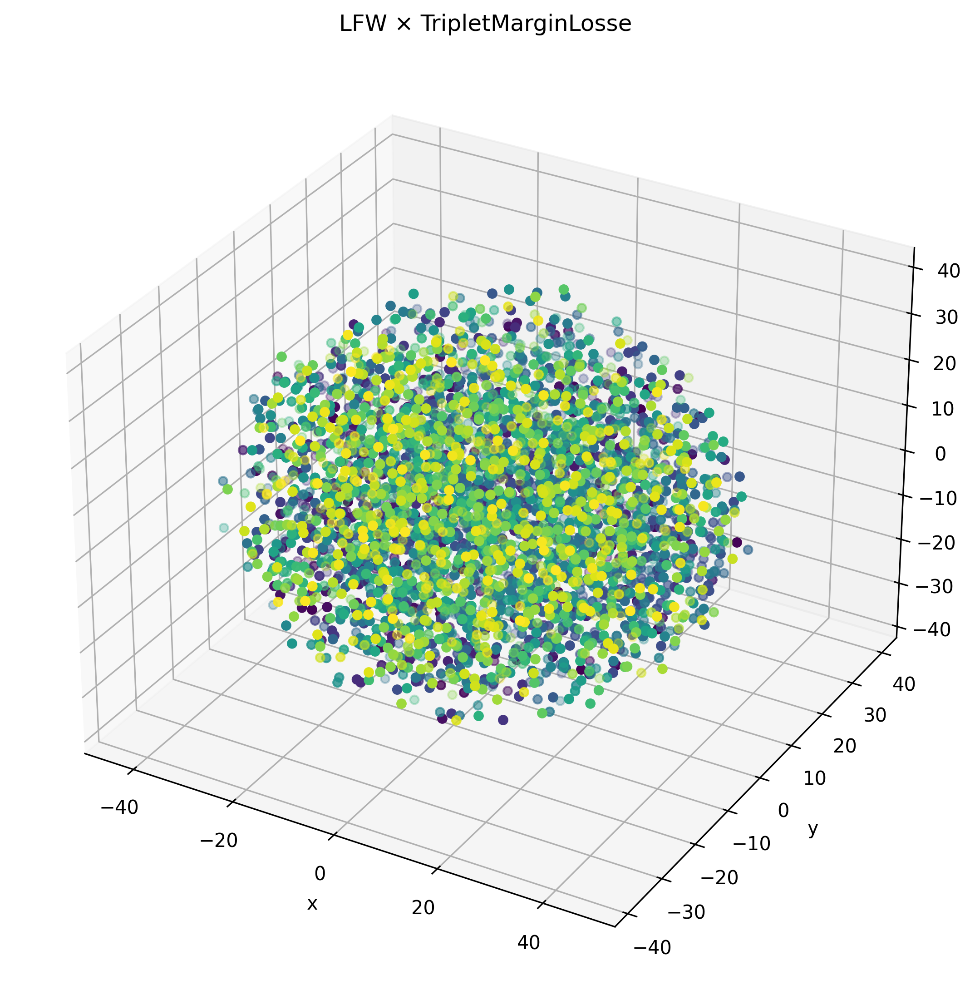

In [ ]:
# 导入matplotlib.pyplot和其他必要的库
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import numpy as np
from sklearn.manifold import TSNE

# 假设你的模型已经训练好了，并且保存在model变量中
# 假设你的测试数据集已经加载好了，并且保存在test_loader变量中

# 创建一个空的列表，用于存储嵌入向量和标签
embeddings = []
labels = []

# 遍历测试数据集，通过模型得到嵌入向量，并将它们和标签添加到列表中
with torch.no_grad(): # 不计算梯度，节省内存和时间
    for data, label in test_loader: # 遍历测试数据
        data = data.to(device) # 将图像移动到设备上
        label = label.to(device) # 将标签移动到设备上
        embedding = model(data) # 通过模型得到嵌入向量
        embeddings.append(embedding) # 将嵌入向量添加到列表中
        labels.append(label) # 将标签添加到列表中

# 将列表转换为numpy数组，并将嵌入向量的维度降为2或3，用于可视化
embeddings = torch.cat(embeddings, dim=0).cpu().numpy() # 将嵌入向量拼接起来，并转换为numpy数组
labels = torch.cat(labels, dim=0).cpu().numpy() # 将标签拼接起来，并转换为numpy数组
tsne = TSNE(n_components=3, perplexity=30, n_iter=1000) # 创建一个TSNE对象，并设置参数
embeddings_3d = tsne.fit_transform(embeddings) # 使用TSNE对象对嵌入向量进行降维，得到三维的坐标

import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import numpy as np
import ipywidgets as widgets
from IPython.display import display

# 创建一个三维的图形对象，并设置标题和坐标轴标签
fig = plt.figure(figsize=(12, 9), dpi=300)
ax = fig.add_subplot(111, projection='3d')
ax.set_title('LFW × TripletMarginLosse')
ax.set_xlabel('x')
ax.set_ylabel('y')
ax.set_zlabel('z')

# 定义一个色系
cmap = plt.get_cmap('viridis')

# 遍历每个类别，绘制对应颜色的散点图，并添加图例
for i in range(num_classes):
    indices = labels == i  # 找到属于该类别的索引
    x = embeddings_3d[indices, 0]  # 找到对应的x坐标
    y = embeddings_3d[indices, 1]  # 找到对应的y坐标
    z = embeddings_3d[indices, 2]  # 找到对应的z坐标
    color = np.array([cmap(float(i) / num_classes)])  # 将颜色值封装为数组
    ax.scatter(x, y, z, c=color, label=str(i))  # 绘制散点图，并设置颜色和标签

# 创建一个输出小部件
output_widget = widgets.Output()

# 显示图像
with output_widget:
    display(fig)

# 创建一个控制旋转的小部件
rotation_slider = widgets.FloatSlider(min=-180, max=180, value=0, description='Rotation')

# 定义一个函数来更新图像的旋转角度
def update_rotation_angle(change):
    angle = change.new
    ax.view_init(elev=30, azim=angle)
    with output_widget:
        output_widget.clear_output(wait=True)
        display(fig)

# 将更新函数绑定到旋转小部件的值变化事件
rotation_slider.observe(update_rotation_angle, 'value')

# 创建一个垂直布局小部件来显示图像和旋转控制
vbox = widgets.VBox([output_widget, rotation_slider])

# 显示垂直布局小部件
display(vbox)
